**CURSO**: Análisis Geoespacial, Departamento de Geociencias y Medio Ambiente, Universidad Nacional de Colombia - sede Medellín <br/>
**Profesor**: Edier Aristizábal (evaristizabalg@unal.edu.co) <br />
**Classroom code**: [32cjlau] <br />
**Credits**: The content of this notebook is taken from several sources, but specially from the courses and book open and freely published by [Dani Arribas-Bel](http://darribas.org/) -  University of Liverpool & - Sergio Rey - [Center for Geospatial Sciences, University of California, Riverside](http://spatial.ucr.edu/peopleRey.html). Every effort has been made to trace copyright holders of the materials used in this book. The author apologies for any unintentional omissions and would be pleased to add an acknowledgment in future editions. 

# Geovisualization

In [8]:
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

import pandas as pd
import geopandas as gpd
import osmnx
import contextily as cx
#from keplergl import KeplerGl
import matplotlib.pyplot as plt

We will learn how to load, manipulate and visualize spatial data. In some senses, spatial data are usually included simply as "one more column" in a table. However, *spatial is special* sometimes and there are few aspects in which geographic data differ from standard numerical tables. In the process, we will discover that, although with some particularities, dealing with spatial data in Python largely resembles dealing with non-spatial data.

## Datasets

To learn these concepts, we will be playing with three main datasets. 

### Cities

First we will use a polygon geography. We will use an open dataset that contains the boundaries of Spanish cities. We can read it into an object named `cities` by:

In [4]:
cities = gpd.read_file("https://ndownloader.figshare.com/files/20232174")
cities.head()

,city_id,n_buildings,geometry
0,ci000,2348,"POLYGON ((385390.071 4202949.446, 384488.697 4..."
1,ci001,2741,"POLYGON ((214893.033 4579137.558, 215258.185 4..."
2,ci002,5472,"POLYGON ((690674.281 4182188.538, 691047.526 4..."
3,ci003,14608,"POLYGON ((513378.282 4072327.639, 513408.853 4..."
4,ci004,2324,"POLYGON ((206989.081 4129478.031, 207275.702 4..."


<AxesSubplot:>

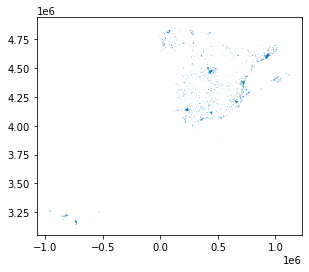

In [9]:
cities.plot()

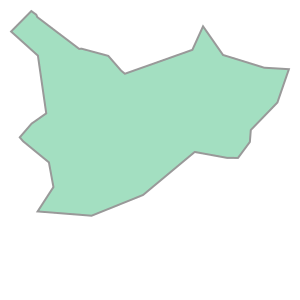

In [18]:
cities.loc[0, 'geometry']

### Streets

In addition to polygons, we will play with a line layer. For that, we are going to use a subset of street network from the Spanish city of Zaragoza. The data is available on the following web address, And you can read it into an object called streets with:

In [6]:
streets = gpd.read_file("https://github.com/geochicasosm/lascallesdelasmujeres/raw/master/data/zaragoza/final_tile.geojson")
streets.head()

,name,id,wikipedia_link,gender,scale,category,typeofroad,geometry
0,Calle Camilo José Cela,78317710,,Male,,None,None,"LINESTRING (-1.03303 41.72464, -1.03346 41.72474)"
1,Calle Mariano Domingo Ruiz,66375846,,Male,,None,None,"LINESTRING (-1.03161 41.72427, -1.03228 41.72347)"
2,Calle Camilo José Cela,78317716,,Male,,None,None,"LINESTRING (-1.02922 41.72311, -1.02966 41.723..."
3,Calle Mariano Lozano Sesma,66375810,,Male,,None,None,"LINESTRING (-1.03148 41.72318, -1.03086 41.72393)"
4,Calle Salvador Dalí,66375807,,Male,,None,None,"LINESTRING (-1.03012 41.72357, -1.03072 41.72285)"


<AxesSubplot:>

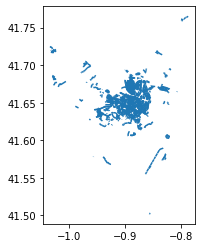

In [19]:
streets.plot()

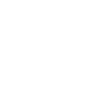

In [20]:
streets.loc[0, 'geometry']

### Bars
The final dataset we will rely on is a set of points demarcating the location of bars in Zaragoza. To obtain it, we will use `osmnx`, a Python library that allows us to query [OpenStreetMap](https://www.openstreetmap.org). Note that we use the method `pois_from_place`, which queries for points of interest (POIs, or `pois`) in a particular place (Zaragoza in this case). In addition, we can specify a set of tags to delimit the query. We use this to ask _only_ for amenities of the type "bar":

In [15]:
pois = osmnx.geometries_from_place("Zaragoza, Spain", tags={"amenity": "bar"})
pois.head(2)

,unique_id,osmid,element_type,amenity,name,sport,wheelchair,wifi,geometry,addr:postcode,...,phone,alt_name,name:en,outdoor_seating,level,brewery,nodes,building,restaurant,operator
0,node/368305154,368305154,node,bar,Lago Ness,darts,no,yes,POINT (-0.89492 41.64197),NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,node/603129991,603129991,node,bar,Vinos Rubio,NaN,NaN,NaN,POINT (-0.89185 41.64214),50006,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [18]:
pois.geometry

0                              POINT (-0.89492 41.64197)
1                              POINT (-0.89185 41.64214)
2                              POINT (-0.89578 41.64349)
3                              POINT (-0.89101 41.66345)
4                              POINT (-0.89693 41.64048)
                             ...                        
227    POLYGON ((-0.92530 41.66064, -0.92522 41.66062...
228    POLYGON ((-0.86310 41.68922, -0.86286 41.68922...
229    POLYGON ((-0.86662 41.69280, -0.86630 41.69298...
230    POLYGON ((-0.79732 41.73130, -0.79763 41.73137...
231    POLYGON ((-0.86976 41.65075, -0.86978 41.65078...
Name: geometry, Length: 232, dtype: geometry

In [20]:
print(pois.geometry[0])

POINT (-0.8949199 41.6419671)


Points take a similar approach for quick plotting:

<AxesSubplot:>

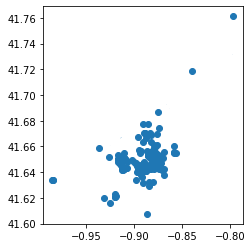

In [11]:
pois.plot()

## Styling plots

It is possible to tweak several aspects of a plot to customize if to particular needs. In this section, we will explore some of the basic elements that will allow us to obtain more compelling maps.

### Changing transparency

The intensity of color of a polygon can be easily changed through the `alpha` attribute in plot. This is specified as a value betwee zero and one, where the former is entirely transparent while the latter is the fully opaque (maximum intensity):

<AxesSubplot:>

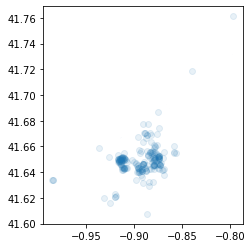

In [12]:
pois.plot(alpha=0.1)

### Removing axes

Although in some cases, the axes can be useful to obtain context, most of the times maps look and feel better without them. Removing the axes involves wrapping the plot into a figure, which takes a few more lines of aparently useless code but that, in time, it will allow you to tweak the map further and to create much more flexible designs:

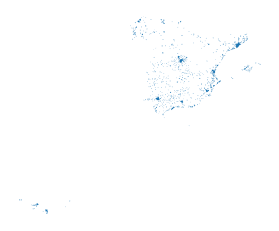

In [13]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Plot layer of polygons on the axis
cities.plot(ax=ax)
# Remove axis frames
ax.set_axis_off()
# Display
plt.show()

### Adding a title

Adding a title is an extra line, if we are creating the plot within a figure, as we just did. To include text on top of the figure:

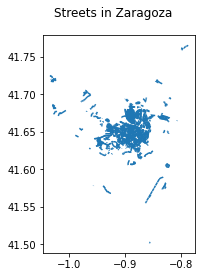

In [14]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add layer of polygons on the axis
streets.plot(ax=ax)
# Add figure title
f.suptitle("Streets in Zaragoza")
# Display
plt.show()

### Changing the size of the map

The size of the plot is changed equally easily in this context. The only difference is that it is specified when we create the figure with the argument `figsize`. The first number represents the width, the X axis, and the second corresponds with the height, the Y axis.

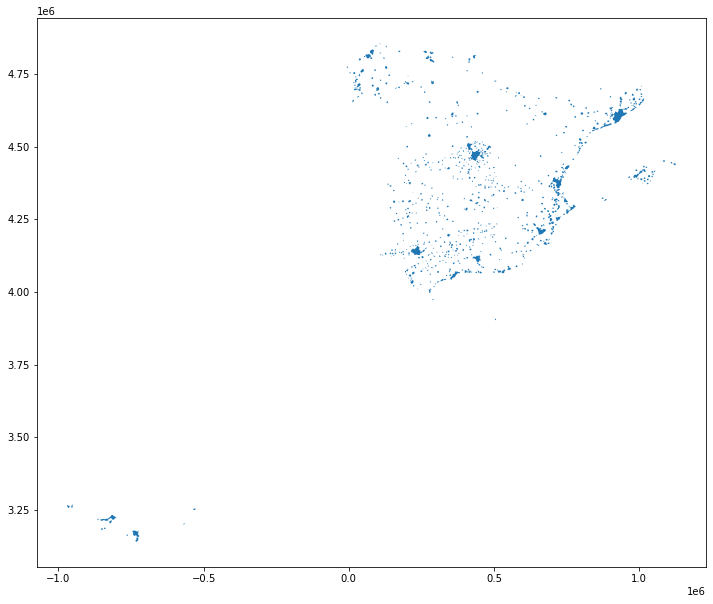

In [15]:
# Setup figure and axis with different size
f, ax = plt.subplots(1, figsize=(12, 12))
# Add layer of polygons on the axis
cities.plot(ax=ax)
# Display
plt.show()

### Modifying borders

Border lines sometimes can distort or impede proper interpretation of a map. In those cases, it is useful to know how they can be modified. Although not too complicated, the way to access borders in `geopandas` is not as straightforward as it is the case for other aspects of the map, such as size or frame. Let us first see the code to make the *lines thicker* and *black*, and then we will work our way through the different steps:

<AxesSubplot:>

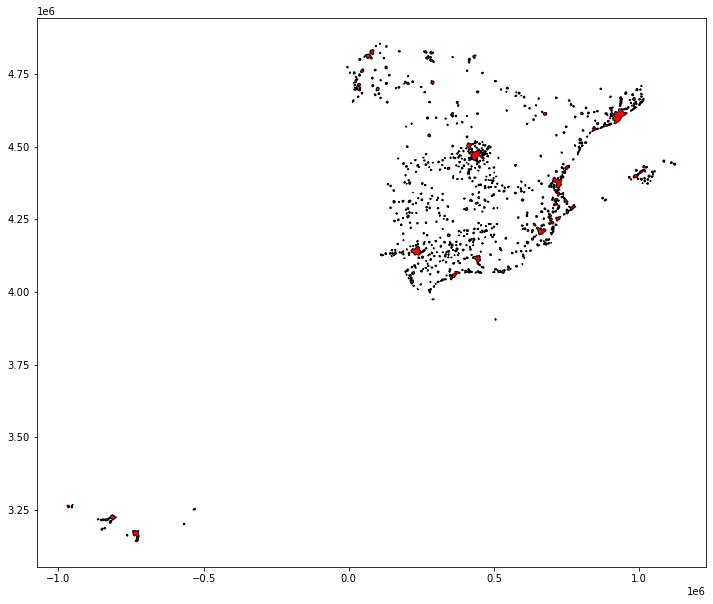

In [16]:
# Setup figure and axis
f, ax = plt.subplots(1, figsize=(12, 12))
# Add layer of polygons on the axis, set fill color (`facecolor`) and boundary
# color (`edgecolor`)
cities.plot(linewidth=1, 
            facecolor='red', 
            edgecolor='black', 
            ax=ax
           )

This approach works very similarly with other geometries, such as lines. For example, if we wanted to plot the streets in red, we would simply:

<AxesSubplot:>

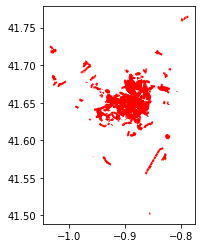

In [17]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add layer with lines, set them red and with different line width
# and append it to the axis `ax`
streets.plot(linewidth=2, color='red', ax=ax)

Important, note that in the case of lines the parameter to control the color is simply `color`. This is because lines do not have an area, so there is no need to distinguish between the main area (`facecolor`) and the border lines (`edgecolor`).

## Coordinate Reference Systems (CRS)
A coordinate reference system (CRS) determines how the two-dimensional (planar) coordinates of the geometry objects should be related to actual places on the (non-planar) earth.

For a nice in-depth explanation, see https://docs.qgis.org/2.8/en/docs/gentle_gis_introduction/coordinate_reference_systems.html

The coordindate reference system (CRS) is the way geographers and cartographers have to represent a three-dimentional object, such as the round earth, on a two-dimensional plane, such as a piece of paper or a computer screen. If the source data contain information on the CRS of the data, we can modify this in a GeoDataFrame.

A GeoDataFrame or GeoSeries has a .crs attribute which holds (optionally) a description of the coordinate reference system of the geometries:

In [18]:
cities.crs

<Projected CRS: EPSG:25830>
Name: ETRS89 / UTM zone 30N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Europe - 6°W to 0°W and ETRS89 by country
- bounds: (-6.0, 35.26, 0.0, 80.53)
Coordinate Operation:
- name: UTM zone 30N
- method: Transverse Mercator
Datum: European Terrestrial Reference System 1989
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

As we can see, there is information stored about the reference system: it is using the standard Spanish projection, which is expressed in meters. There are also other less decipherable parameters but we do not need to worry about them right now.

If we want to modify this and "reproject" the polygons into a different CRS, the quickest way is to find the [EPSG](https://en.wikipedia.org/wiki/International_Association_of_Oil_%26_Gas_Producers#European_Petroleum_Survey_Group) code online ([epsg.io](http://epsg.io/) is a good one, although there are others too). For example, if we wanted to transform the dataset into lat/lon coordinates, we would use its EPSG code, 4326:

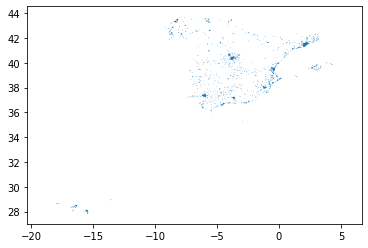

In [19]:
# Reproject (`to_crs`) and plot (`plot`) polygons
cities.to_crs(epsg=4326).plot()
# Set equal axis
lims = plt.axis('equal')

The shape of the polygons is slightly different. Furthermore, note how the *scale* in which they are plotted differs.

For more information, see also http://geopandas.readthedocs.io/en/latest/projections.html.

There are sometimes good reasons you want to change the coordinate references system of your dataset, for example:

- different sources with different crs -> need to convert to the same crs
- distance-based operations -> if you a crs that has meter units (not degrees)
- plotting in a certain crs (eg to preserve area)

We can convert a GeoDataFrame to another reference system using the to_crs function.

## Scale

[scale-bar](https://github.com/ppinard/matplotlib-scalebar) provides a new artist for matplotlib to display a scale bar, aka micron bar. It is particularly useful when displaying calibrated images plotted using plt.imshow(...).

If you are plotting geospatial coordinates (such as scatterplots of the location of structures, geopandas geodataframe plots, etc.), dx needs to be set differently depending on the coordinate system:

* For UTM based coordinate system, where the X and Y are in meters, simply set dx = 1.
* For WGS or NAD based coordinate system, where X and Y are in latitude (Y) and longitude (X), compute the distance between two points at the latitude (Y) you wish to have the scale represented and are also one full degree of longitude (X) apart, in meters. For example, dx = great_circle_distance((X, Y), (X + 1, Y))

In [116]:
import math

EARTH_CIRCUMFERENCE = 6378137     # earth circumference in meters

def great_circle_distance(latlong_a, latlong_b):
    """
    >>> coord_pairs = [
    ...     # between eighth and 31st and eighth and 30th
    ...     [(40.750307,-73.994819), (40.749641,-73.99527)],
    ...     # sanfran to NYC ~2568 miles
    ...     [(37.784750,-122.421180), (40.714585,-74.007202)],
    ...     # about 10 feet apart
    ...     [(40.714732,-74.008091), (40.714753,-74.008074)],
    ...     # inches apart
    ...     [(40.754850,-73.975560), (40.754851,-73.975561)],
    ... ]
    
    >>> for pair in coord_pairs:
    ...     great_circle_distance(pair[0], pair[1]) # doctest: +ELLIPSIS
    83.325362855055...
    4133342.6554530...
    2.7426970360283...
    0.1396525521278...
    """
    lat1, lon1 = latlong_a
    lat2, lon2 = latlong_b

    dLat = math.radians(lat2 - lat1)
    dLon = math.radians(lon2 - lon1)
    a = (math.sin(dLat / 2) * math.sin(dLat / 2) +
            math.cos(math.radians(lat1)) * math.cos(math.radians(lat2)) * 
            math.sin(dLon / 2) * math.sin(dLon / 2))
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    d = EARTH_CIRCUMFERENCE * c
    
    return d

In [117]:
X=-75
Y=6
dx = great_circle_distance((X, Y), (X + 1, Y))
dx

111319.49079327357

In [113]:
!pip install matplotlib-scalebar

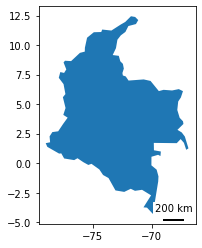

In [118]:
from matplotlib_scalebar.scalebar import ScaleBar
ax=colombia.plot()
# Create scale bar
scalebar = ScaleBar(dx, "m", location="lower right", scale_loc="top", length_fraction=0.25)
ax.add_artist(scalebar)

## Composing multi-layer maps

So far we have considered many aspects of plotting *a single* layer of data. However, in many cases, an effective map will require more than one: for example we might want to display streets on top of the polygons of neighborhoods, and add a few points for specific locations we want to highlight. At the very heart of GIS is the possibility to combine spatial information from different sources by overlaying it on top of each other, and this is fully supported in Python.

For this section, let's select only Zaragoza from the `streets` table and convert it to lat/lon so it's aligned with the streets and POIs layers:

In [20]:
zgz = cities.loc[[112], :].to_crs(epsg=4326)
zgz

,city_id,n_buildings,geometry
112,ci122,23604,"POLYGON ((-0.93057 41.60615, -0.93092 41.60622..."


Combining different layers on a single map boils down to adding each of them to the same axis in a sequential way, as if we were literally overlaying one on top of the previous one. For example, let's plot the boundary of Zaragoza and its bars:

<AxesSubplot:>

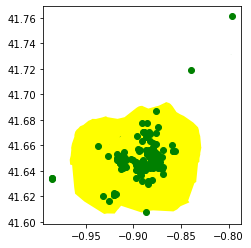

In [21]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygon on to axis `ax`
zgz.plot(ax=ax, color="yellow")
# Add a layer with lines on top in axis `ax`
pois.plot(ax=ax, color="green")

## Saving maps to figures

Once we have produced a map we are content with, we might want to save it to a file so we can include it into a report, article, website, etc. Exporting maps in Python involves replacing `plt.show` by `plt.savefig` at the end of the code block to specify where and how to save it. For example to save the previous map into a `png` file in the same folder where the notebook is hosted:

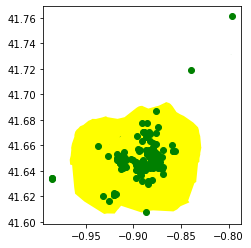

In [22]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygon on to axis `ax`
zgz.plot(ax=ax, color="yellow")
# Add a layer with lines on top in axis `ax`
pois.plot(ax=ax, color="green")
# Save figure to a PNG file
plt.savefig('zaragoza_bars.png')

If you now check on the folder, you'll find a `png` (image) file with the map.

The command `plt.savefig` contains a large number of options and additional parameters to tweak. Given the size of the figure created is not very large, we can increase this with the argument `dpi`, which stands for "dots per inch" and it's a standard measure of resolution in images. For example, for a high quality image, we could use 500:

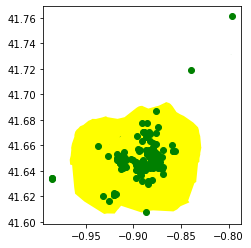

In [23]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygon on to axis `ax`
zgz.plot(ax=ax, color="yellow")
# Add a layer with lines on top in axis `ax`
pois.plot(ax=ax, color="green")
# Save figure to a PNG file
plt.savefig('zaragoza_bars.png', dpi=500)

## Manipulating spatial tables (`GeoDataFrames`)

Once we have an understanding of how to visually display spatial information contained, let us see how it can be combined with the operations learnt in the previous session about manipulating non-spatial tabular data. Essentially, the key is to realize that a `GeoDataFrame` contains most of its spatial information in a single column named `geometry`, but the rest of it looks and behaves exactly like a non-spatial `DataFrame` (in fact, it is). This concedes them all the flexibility and convenience that we saw in manipulating, slicing, and transforming tabular data, with the bonus that spatial data is carried away in all those steps. In addition, `GeoDataFrames` also incorporate a set of explicitly spatial operations to combine and transform data. In this section, we will consider both.

`GeoDataFrame`s come with a whole range of traditional GIS operations built-in. Here we will run through a small subset of them that contains some of the most commonly used ones.

### Area calculation

One of the spatial aspects we often need from polygons is their area. "How big is it?" is a question that always haunts us when we think of countries, regions, or cities. To obtain area measurements, first make sure you `GeoDataFrame` {ref}`is projected <lab_C:to_crs>`. If that is the case, you can calculate areas as follows:

In [24]:
city_areas = cities.area
city_areas.head()

0    8.449666e+06
1    9.121270e+06
2    1.322653e+07
3    6.808121e+07
4    1.072284e+07
dtype: float64

This indicates that the area of the first city in our table takes up 8,450,000 squared metres. If we wanted to convert into squared kilometres, we can divide by 1,000,000:

In [26]:
areas_in_sqkm = city_areas / 1000000
areas_in_sqkm.head()

0     8.449666
1     9.121270
2    13.226528
3    68.081212
4    10.722843
dtype: float64

(lab_C:length)=
### Length

Similarly, an equally common question with lines is their length. Also similarly, their computation is relatively straightforward in Python, provided that our data are projected. Here we will perform the projection (`to_crs`) and the calculation of the length at the same time:

In [30]:
street_length = streets.to_crs(epsg=25830).length
street_length.head()

0     37.338828
1    104.510732
2    365.969719
3     97.101436
4     94.002218
dtype: float64

Since the CRS we use (`EPSG:25830`) is expressed in metres, we can tell the first street segment is about 37m.

### Centroid calculation

Sometimes it is useful to summarize a polygon into a single point and, for that, a good candidate is its centroid (almost like a spatial analogue of the average). The following command will return a `GeoSeries` (a single column with spatial data) with the centroids of a polygon `GeoDataFrame`:

In [24]:
cents = cities.centroid
cents.head()

0    POINT (386147.759 4204605.994)
1    POINT (216296.159 4579397.331)
2    POINT (688901.588 4180201.774)
3    POINT (518262.028 4069898.674)
4    POINT (206940.936 4127361.966)
dtype: geometry

Note how `cents` is not an entire table but a single column, or a `GeoSeries` object. This means you can plot it directly, just like a table:

<AxesSubplot:>

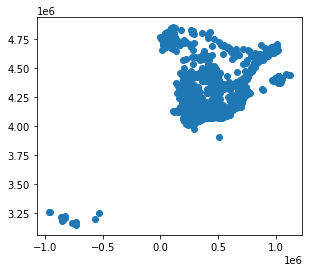

In [25]:
cents.plot()

But you don't need to call a `geometry` column to inspect the spatial objects. In fact, if you do it will return an error because there is not any `geometry` column, the object `cents` itself is the geometry.

### Point in polygon (PiP)

Knowing whether a point is inside a polygon is conceptually a straightforward exercise but computationally a tricky task to perform. The way to perform this operation in `GeoPandas` is through the `contains` method, available for each polygon object.

In [26]:
poly = cities.loc[112, "geometry"]
pt1 = cents[0]
pt2 = cents[112]

And we can perform the checks as follows:

In [27]:
poly.contains(pt1)

False

In [28]:
poly.contains(pt2)

True

Performing point-in-polygon in this way is instructive and useful for pedagogical reasons, but for cases with many points and polygons, it is not particularly efficient. In these situations, it is much more advisable to perform then as a "spatial join". If you are interested in these, see the link provided below to learn more about them.

### Buffers

Buffers are one of the classical GIS operations in which an area is drawn around a particular geometry, given a specific radious. These are very useful, for instance, in combination with point-in-polygon operations to calculate accessibility, catchment areas, etc.

For this example, we will use the bars table, but will project it to the same CRS as `cities`, so it is expressed in metres:

In [29]:
pois_projected = pois.to_crs(cities.crs)
pois_projected.crs

<Projected CRS: EPSG:25830>
Name: ETRS89 / UTM zone 30N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Europe - 6°W to 0°W and ETRS89 by country
- bounds: (-6.0, 35.26, 0.0, 80.53)
Coordinate Operation:
- name: UTM zone 30N
- method: Transverse Mercator
Datum: European Terrestrial Reference System 1989
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

To create a buffer using `geopandas`, simply call the `buffer` method, passing in the radious. For example, to draw a 500m. buffer around every bar in Zaragoza:

In [30]:
buf = pois_projected.buffer(500)
buf.head()

603129991    POLYGON ((676071.164 4612191.116, 676068.756 4...
673807647    POLYGON ((675740.197 4612333.309, 675737.789 4...
759470843    POLYGON ((676083.551 4614558.818, 676081.143 4...
765953540    POLYGON ((675653.012 4611997.279, 675650.604 4...
772973291    POLYGON ((675616.277 4614955.710, 675613.870 4...
dtype: geometry

And plotting it is equally straighforward:

<AxesSubplot:>

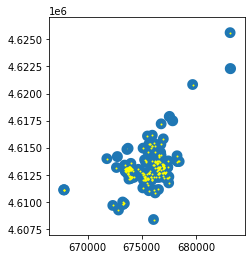

In [31]:
f, ax = plt.subplots(1)
# Plot buffer
buf.plot(ax=ax, linewidth=0)
# Plot named places on top for reference
# [NOTE how we modify the dot size (`markersize`)
# and the color (`color`)]
pois_projected.plot(ax=ax, markersize=1, color='yellow')

In [119]:
gt_points = pd.read_csv("https://geographicdata.science/book/_downloads/7fb86b605af15b3c9cbd9bfcbead23e9/tokyo_clean.csv")
gt_points.head(2)

,user_id,longitude,latitude,date_taken,photo/video_page_url,x,y
0,10727420@N00,139.700499,35.674000,2010-04-09 17:26:25.0,http://www.flickr.com/photos/10727420@N00/4545...,1.555139e+07,4.255856e+06
1,8819274@N04,139.766521,35.709095,2007-02-10 16:08:40.0,http://www.flickr.com/photos/8819274@N04/26503...,1.555874e+07,4.260667e+06


In [120]:
pt_geoms = gpd.points_from_xy(x=gt_points["longitude"],
                                    y=gt_points["latitude"],
                                    crs="EPSG:4326"
                                   )

In [121]:
gt_points = gpd.GeoDataFrame(gt_points,geometry=pt_geoms)
type(gt_points)

geopandas.geodataframe.GeoDataFrame

In [122]:
latitudes=gt_points["latitude"]
longitudes=gt_points["longitude"]

## Interactive maps: Adding base layers from web sources

Everything we have seen so far relates to static maps. These are useful for publication, to include in reports or to print. However, modern web technologies afford much more flexibility to explore spatial data interactively.

### Folium

[Folium](https://python-visualization.github.io/folium/) is a Python library used for visualizing geospatial data. It is easy to use and yet a powerful library. Folium is a Python wrapper for Leaflet. js which is a leading open-source JavaScript library for plotting interactive maps.

In [21]:
import folium

In [22]:
folium.Map(location = [4.664827, -76.516], zoom_start = 6)

In [60]:
m.save("index.html")

In [24]:
folium.Map(location= [4.665, -76.516], zoom_start = 6, tiles = 'Stamen Toner')

In [25]:
folium.Map(location= [4.665, -76.516], zoom_start = 6, tiles = 'Stamen Terrain')

In [67]:
m = folium.Map(location=[6.2443382, -75.573553], zoom_start=13, width='100%',height='100%')
folium.Marker([6.2443382, -75.573553], popup="<i>Medellín</i>", tooltip="Click me").add_to(m)
folium.Marker([6.2444000, -75.591000], icon=folium.Icon(icon="cloud", color='green')).add_to(m)
folium.Circle(radius=500, location=[6.2444000, -75.598000], color="#3186cc", fill=True, fill_color="#3186cc",weight=3).add_to(m)

m

In [31]:
df = pd.read_csv("https://geographicdata.science/book/_downloads/7fb86b605af15b3c9cbd9bfcbead23e9/tokyo_clean.csv")
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude, crs="EPSG:4326"))
gdf.head(2)

,user_id,longitude,latitude,date_taken,photo/video_page_url,x,y,geometry
0,10727420@N00,139.700499,35.674000,2010-04-09 17:26:25.0,http://www.flickr.com/photos/10727420@N00/4545...,1.555139e+07,4.255856e+06,POINT (139.70050 35.67400)
1,8819274@N04,139.766521,35.709095,2007-02-10 16:08:40.0,http://www.flickr.com/photos/8819274@N04/26503...,1.555874e+07,4.260667e+06,POINT (139.76652 35.70909)


In [32]:
tokyo = folium.Map(location= [35.5, 139.5], zoom_start = 10)
places = folium.map.FeatureGroup()
for lat, lng, in zip(gdf.latitude, gdf.longitude):
    places.add_child(
    folium.CircleMarker(
    [lat, lng],
    radius=5,
    color='yellow',
    fill=True,
    fill_color='blue',
    fill_opacity=0.6))
tokyo.add_child(places)

In [69]:
m = folium.Map(location=[48, -102], zoom_start=3)

folium.Choropleth(
    geo_data="https://raw.githubusercontent.com/python-visualization/folium/master/examples/data/us-states.json",
    name="choropleth",
    data=pd.read_csv("https://raw.githubusercontent.com/python-visualization/folium/master/examples/data/US_Unemployment_Oct2012.csv"),
    columns=["State", "Unemployment"],
    key_on="feature.id",
    fill_color="YlGn",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Unemployment Rate (%)",
).add_to(m)

folium.LayerControl().add_to(m)

m

we employ a data set, containing information about gross birth rates (births per 1000 inhabitants) from 1975 until 2018 across communities in Spain.

In [83]:
gdf = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
gdf.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [107]:
df=gdf[["pop_est","name"]]
df.head()

,pop_est,name
0,920938,Fiji
1,53950935,Tanzania
2,603253,W. Sahara
3,35623680,Canada
4,326625791,United States of America


In [111]:
# create a plain world map
communities_map = folium.Map(location=[40.416775, -3.703790], zoom_start=2, tiles='stamenwatercolor')

# generate choropleth map 
communities_map.choropleth(
    geo_data=gdf,
    data=df,
    columns=['pop_est', 'name'],
    fill_color='YlGnBu', 
    fill_opacity=1, 
    line_opacity=1,
    legend_name='Births per 1000 inhabitants',
    smooth_factor=0)

# display map
communities_map

### OSMNX


[OSMnx](https://github.com/gboeing/osmnx) is a Python package that lets you download spatial data from OpenStreetMap and model, project, visualize, and analyze real-world street networks.

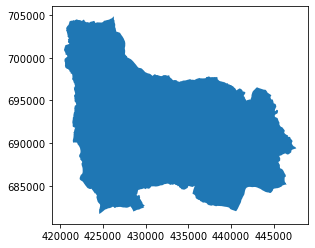

In [148]:
import osmnx as ox
city = ox.geocode_to_gdf('Medellín, Colombia')
ax = ox.project_gdf(city).plot()

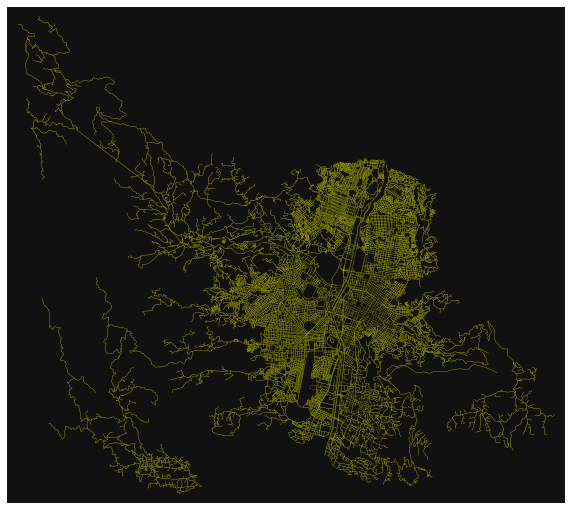

(<Figure size 720x720 with 1 Axes>, <AxesSubplot:>)

In [149]:
import osmnx as ox
G = ox.graph_from_place('Medellín, Colombia', network_type='drive')
ox.plot_graph(G, figsize=(10, 10), node_size=0, edge_color='y', edge_linewidth=0.2)

Create new dataframe to collect street networks within each voronoi regions

In [150]:
# get all the parks in some neighborhood
# constrain acceptable `leisure` tag values to `park`
place = 'Medellín, Colombia'
tags = {'leisure': 'park'}
gdf = ox.geometries_from_place(place, tags)
gdf.head()

,unique_id,osmid,element_type,geometry,name,leisure,description,name:en,tourism,wikidata,...,denomination,surface,opening_hours:covid19,access,dog,note,addr:postcode,ways,fixme,type
0,node/3698821056,3698821056,node,POINT (-75.59766 6.21591),Canalización La Mota,park,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,node/3748104496,3748104496,node,POINT (-75.53658 6.29701),parque,park,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,node/3799873281,3799873281,node,POINT (-75.53896 6.29658),NaN,park,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,node/4177117294,4177117294,node,POINT (-75.54455 6.29402),DE PAN,park,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,node/4177131411,4177131411,node,POINT (-75.54495 6.29082),Parque De La Cancha,park,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [154]:
# get everything tagged amenity,
# and everything tagged landuse = retail or commercial,
# and everything tagged highway = bus_stop
tags = {'amenity' : True,
        'landuse' : ['retail', 'commercial'],
        'highway' : 'bus_stop'}
gdf = ox.geometries_from_place('Medellín, Colombia', tags)
gdf.shape

(4186, 229)

In [155]:
# view just the banks
gdf[gdf['amenity']=='bank'].dropna(axis=1, how='any')

,unique_id,osmid,element_type,amenity,geometry
3,node/338172348,338172348,node,bank,POINT (-75.57888 6.18369)
139,node/1301957616,1301957616,node,bank,POINT (-75.57338 6.24506)
199,node/1656789265,1656789265,node,bank,POINT (-75.57246 6.20187)
201,node/1657087256,1657087256,node,bank,POINT (-75.57177 6.20652)
205,node/1661049493,1661049493,node,bank,POINT (-75.57395 6.19703)
...,...,...,...,...,...
3591,way/576893946,576893946,way,bank,"POLYGON ((-75.56390 6.25020, -75.56381 6.25037..."
3602,way/578911169,578911169,way,bank,"POLYGON ((-75.57308 6.24206, -75.57301 6.24223..."
3603,way/579013177,579013177,way,bank,"POLYGON ((-75.57333 6.24935, -75.57329 6.24945..."
3617,way/579440533,579440533,way,bank,"POLYGON ((-75.55390 6.30649, -75.55385 6.30648..."


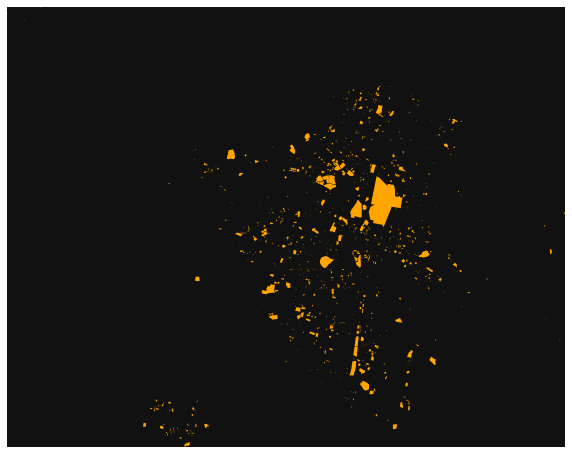

In [156]:
fig, ax = ox.plot_footprints(gdf, figsize=(10, 10))

### Contextily
Many single datasets lack context when displayed on their own. A common approach to alleviate this is to use web tiles, which are a way of quickly obtaining geographical context to present spatial data. In Python, we can use [`contextily`](https://contextily.readthedocs.io) to pull down tiles and display them along with our own geographic data.

We can begin by creating a map in the same way we would do normally, and then use the `add_basemap` command to, er, add a basemap:

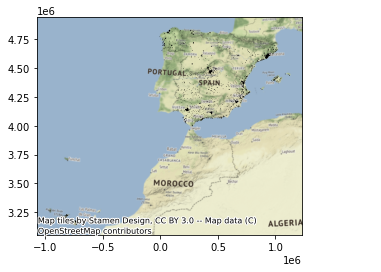

In [32]:
ax = cities.plot(color="black")
cx.add_basemap(ax, crs=cities.crs);

Note that we need to be explicit when adding the basemap to state the coordinate reference system (`crs`) our data is expressed in, `contextily` will not be able to pick it up otherwise. Conversely, we could change our data's CRS into [Pseudo-Mercator](http://epsg.io/3857), the native reference system for most web tiles:

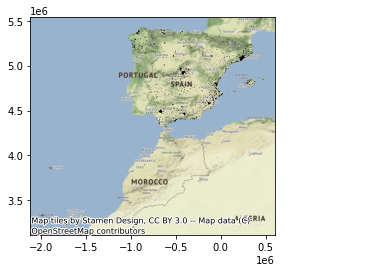

In [33]:
cities_wm = cities.to_crs(epsg=3857)
ax = cities_wm.plot(color="black")
cx.add_basemap(ax);

Note how the coordinates are different but, if we set it right, either approach aligns tiles and data nicely.

Web tiles can be integrated with other features of maps in a similar way as we have seen above. So, for example, we can change the size of the map, and remove the axis. Let's use Zaragoza for this example:

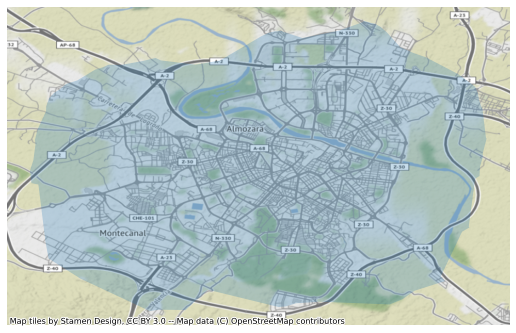

In [34]:
f, ax = plt.subplots(1, figsize=(9, 9))
zgz.plot(alpha=0.25, ax=ax)
cx.add_basemap(ax, crs=zgz.crs)
ax.set_axis_off()

Now, `contextily` offers a lot of options in terms of the sources and providers you can use to create your basemaps. For example, we can use satellite imagery instead:

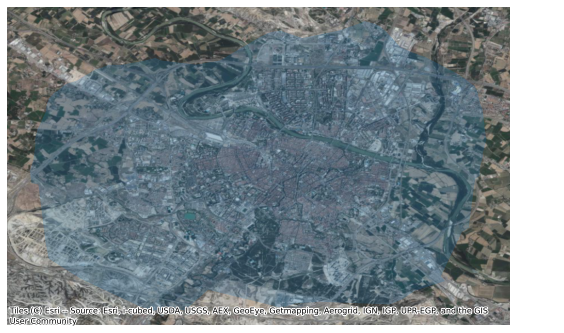

In [35]:
f, ax = plt.subplots(1, figsize=(9, 9))
zgz.plot(alpha=0.25, ax=ax)
cx.add_basemap(ax, 
               crs=zgz.crs,
               source=cx.providers.Esri.WorldImagery
              )
ax.set_axis_off()

And consider checking out the documentation website for the package:

> [https://contextily.readthedocs.io/en/latest/](https://contextily.readthedocs.io/en/latest/)

## Geoviews

[GeoViews](https://geoviews.org/) is a Python library that makes it easy to explore and visualize geographical, meteorological, and oceanographic datasets, such as those used in weather, climate, and remote sensing research.

In [34]:
#Para installar en Google Colab
!apt-get install libgeos++ libproj-dev
!pip install geoviews

E: Could not open lock file /var/lib/dpkg/lock-frontend - open (13: Permission denied)
E: Unable to acquire the dpkg frontend lock (/var/lib/dpkg/lock-frontend), are you root?
     |████████████████████████████████| 502 kB 1.0 MB/s eta 0:00:01
     |████████████████████████████████| 10.6 MB 7.3 MB/s eta 0:00:01
     |████████████████████████████████| 12.1 MB 7.1 MB/s eta 0:00:01    |███▌                            | 1.3 MB 8.7 MB/s eta 0:00:02
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 4.3 MB 10.6 MB/s eta 0:00:01
     |████████████████████████████████| 9.0 MB 7.9 MB/s eta 0:00:01
     |████████████████████████████████| 219 kB 8.5 MB/s eta 0:00:01
     |████████████████████████████████| 240 kB 9.1 MB/s eta 0:00:01
     |████████████████████████████████| 97 kB 4.1 MB/s eta 0:00:011
  Created wheel for bokeh: filename=bokeh-2.3.1-py3-none-any.whl size=11299678 sha256

/opt/conda/lib/python3.8/site-packages/param/parameterized.py:998: DeprecationWarning: invalid escape sequence \.
  """
/opt/conda/lib/python3.8/site-packages/holoviews/operation/datashader.py:5: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3, and in 3.9 it will stop working
  from collections import Callable
/opt/conda/lib/python3.8/site-packages/numba/core/ir.py:29: DeprecationWarning: invalid escape sequence \s
  _defmatcher = re.compile('def\s+(\w+)\(.*')
/opt/conda/lib/python3.8/site-packages/numba/core/ir.py:1573: DeprecationWarning: invalid escape sequence \l
  ['  {}\l'.format(x) for x in label.splitlines()],
/opt/conda/lib/python3.8/site-packages/numba/core/ir.py:1575: DeprecationWarning: invalid escape sequence \l
  label = "block {}\l".format(k) + label
/opt/conda/lib/python3.8/site-packages/numba/core/ir.py:1578: DeprecationWarning: invalid escape sequence \l
  label = "{}\l".format(k)
/opt

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
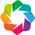

In [35]:
import geoviews as gv
import geoviews.feature as gf
from geoviews import opts
from cartopy import crs 
import geoviews.tile_sources as gts
from geoviews import opts
from geoviews import opts, tile_sources as gvts
from geoviews import dim, opts
gv.extension('bokeh', 'matplotlib')

In [36]:
gts.tile_sources

{'CartoDark': :WMTS   [Longitude,Latitude],
 'CartoEco': :WMTS   [Longitude,Latitude],
 'CartoLight': :WMTS   [Longitude,Latitude],
 'CartoMidnight': :WMTS   [Longitude,Latitude],
 'StamenTerrain': :WMTS   [Longitude,Latitude],
 'StamenTerrainRetina': :WMTS   [Longitude,Latitude],
 'StamenWatercolor': :WMTS   [Longitude,Latitude],
 'StamenToner': :WMTS   [Longitude,Latitude],
 'StamenTonerBackground': :WMTS   [Longitude,Latitude],
 'StamenLabels': :WMTS   [Longitude,Latitude],
 'EsriImagery': :WMTS   [Longitude,Latitude],
 'EsriNatGeo': :WMTS   [Longitude,Latitude],
 'EsriUSATopo': :WMTS   [Longitude,Latitude],
 'EsriTerrain': :WMTS   [Longitude,Latitude],
 'EsriReference': :WMTS   [Longitude,Latitude],
 'EsriOceanBase': :WMTS   [Longitude,Latitude],
 'EsriOceanReference': :WMTS   [Longitude,Latitude],
 'OSM': :WMTS   [Longitude,Latitude],
 'Wikipedia': :WMTS   [Longitude,Latitude]}

In [37]:
stockholm = ( 18.070625,59.320462, 'Stockholm')
london = ( -0.135593, 51.507020, 'London')
istanbul = ( 28.981856, 41.008327, 'Istanbul')
mogadishu = ( 45.299626, 2.042388, 'Mogadishu')

In [38]:
cities = gv.Points([stockholm, london, istanbul, mogadishu], vdims='City')
cities.dframe()

,x,y,City
0,18.070625,59.320462,Stockholm
1,-0.135593,51.507020,London
2,28.981856,41.008327,Istanbul
3,45.299626,2.042388,Mogadishu


In [39]:
cities.opts(opts.Points(global_extent=True, width=500, height=475, size=12, color='black'))

:Points   [x,y]   (City)

In [40]:
gv.Layout([ts.relabel(name) for name, ts in gts.tile_sources.items()]).opts('WMTS', xaxis=None, yaxis=None, width=225, height=225).cols(6)

:Layout
   .WMTS.CartoDark             :WMTS   [Longitude,Latitude]
   .WMTS.CartoEco              :WMTS   [Longitude,Latitude]
   .WMTS.CartoLight            :WMTS   [Longitude,Latitude]
   .WMTS.CartoMidnight         :WMTS   [Longitude,Latitude]
   .WMTS.StamenTerrain         :WMTS   [Longitude,Latitude]
   .WMTS.StamenTerrainRetina   :WMTS   [Longitude,Latitude]
   .WMTS.StamenWatercolor      :WMTS   [Longitude,Latitude]
   .WMTS.StamenToner           :WMTS   [Longitude,Latitude]
   .WMTS.StamenTonerBackground :WMTS   [Longitude,Latitude]
   .WMTS.StamenLabels          :WMTS   [Longitude,Latitude]
   .WMTS.EsriImagery           :WMTS   [Longitude,Latitude]
   .WMTS.EsriNatGeo            :WMTS   [Longitude,Latitude]
   .WMTS.EsriUSATopo           :WMTS   [Longitude,Latitude]
   .WMTS.EsriTerrain           :WMTS   [Longitude,Latitude]
   .WMTS.EsriReference         :WMTS   [Longitude,Latitude]
   .WMTS.EsriOceanBase         :WMTS   [Longitude,Latitude]
   .WMTS.EsriOceanReference    :WMTS   [Longitude,Latitude]
   .WMTS.OSM                   :WMTS   [Longitude,Latitude]
   .WMTS.Wikipedia             :WMTS   [Longitude,Latitude]

In [41]:
gv.tile_sources.OSM.opts( width=800, height=600)

:WMTS   [Longitude,Latitude]

In [42]:
(gv.tile_sources.CartoDark * cities).opts(opts.Points(global_extent=True, width=800, height=600, size=8, color='red'))

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [x,y]   (City)

<ipython-input-43-cb1643e7ce00>:6: UserWarning: The default value for the *approx* keyword argument to OSGB will change from True to False after 0.18.
  proj_layout = gv.Layout([gf.coastline.relabel(group=p.__name__).opts(projection=p(), backend='matplotlib')
<ipython-input-43-cb1643e7ce00>:6: UserWarning: The default value for the *approx* keyword argument to OSNI will change from True to False after 0.18.
  proj_layout = gv.Layout([gf.coastline.relabel(group=p.__name__).opts(projection=p(), backend='matplotlib')
/opt/conda/lib/python3.8/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naciscdn.org/naturalearth/110m/physical/ne_110m_coastline.zip
  warnings.warn('Downloading: {}'.format(url), DownloadWarning)


:Layout
   .RotatedPole.I                :Feature   [Longitude,Latitude]
   .LambertCylindrical.I         :Feature   [Longitude,Latitude]
   .Geostationary.I              :Feature   [Longitude,Latitude]
   .AzimuthalEquidistant.I       :Feature   [Longitude,Latitude]
   .OSGB.I                       :Feature   [Longitude,Latitude]
   .EuroPP.I                     :Feature   [Longitude,Latitude]
   .Gnomonic.I                   :Feature   [Longitude,Latitude]
   .Mollweide.I                  :Feature   [Longitude,Latitude]
   .OSNI.I                       :Feature   [Longitude,Latitude]
   .Miller.I                     :Feature   [Longitude,Latitude]
   .InterruptedGoodeHomolosine.I :Feature   [Longitude,Latitude]
   .SouthPolarStereo.I           :Feature   [Longitude,Latitude]
   .Orthographic.I               :Feature   [Longitude,Latitude]
   .NorthPolarStereo.I           :Feature   [Longitude,Latitude]
   .Robinson.I                   :Feature   [Longitude,Latitude]
   .LambertConformal.I           :Feature   [Longitude,Latitude]
   .AlbersEqualArea.I            :Feature   [Longitude,Latitude]
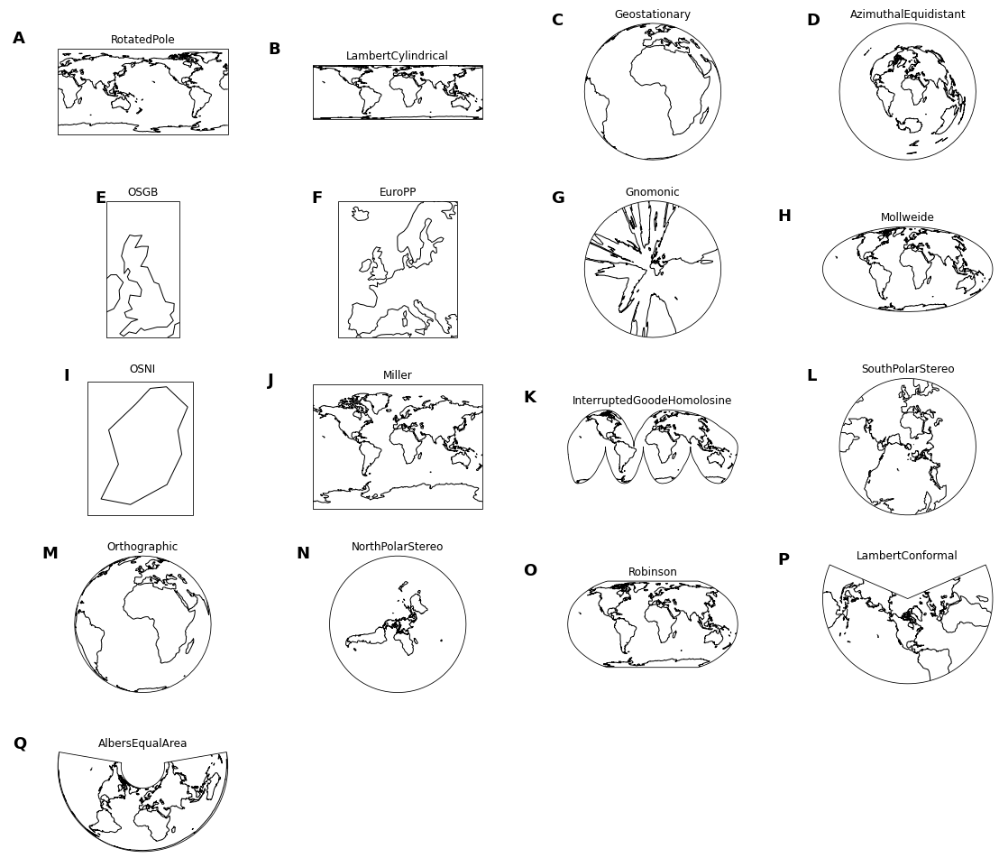

In [43]:
projections = [crs.RotatedPole, crs.LambertCylindrical, crs.Geostationary, 
 crs.AzimuthalEquidistant, crs.OSGB, crs.EuroPP, crs.Gnomonic,
 crs.Mollweide, crs.OSNI, crs.Miller, crs.InterruptedGoodeHomolosine,
 crs.SouthPolarStereo, crs.Orthographic, crs.NorthPolarStereo, crs.Robinson,
 crs.LambertConformal, crs.AlbersEqualArea]
proj_layout = gv.Layout([gf.coastline.relabel(group=p.__name__).opts(projection=p(), backend='matplotlib')
 for p in projections])
gv.output(proj_layout, backend='matplotlib')

In [45]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

In [46]:
world_poly = gv.Polygons(world).opts(color='gray', line_color='white' )

In [47]:
(world_poly * gf.ocean * cities).opts(projection=crs.Orthographic(central_longitude=0.1, central_latitude=22), global_extent=True, width=600, tools=['hover'])

/opt/conda/lib/python3.8/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naciscdn.org/naturalearth/110m/physical/ne_110m_ocean.zip
  warnings.warn('Downloading: {}'.format(url), DownloadWarning)


:Overlay
   .Polygons.I :Polygons   [Longitude,Latitude]   (pop_est,continent,name,iso_a3,gdp_md_est)
   .Ocean.I    :Feature   [Longitude,Latitude]
   .Points.I   :Points   [x,y]   (City)

In [48]:
gv.Polygons(world, vdims=['name', 'pop_est', 'gdp_md_est'], label='World Population').opts(color='pop_est',cmap='blues', colorbar=True)

:Polygons   [Longitude,Latitude]   (name,pop_est,gdp_md_est)

In [49]:
coountries_grouped = gv.Polygons(world, vdims=['name', 'continent'],label='Continent').groupby('continent')

In [50]:
continents = coountries_grouped.opts(width=600, height=400, tools=['hover'], infer_projection=True)
continents

:HoloMap   [continent]
   :Polygons   [Longitude,Latitude]   (name,continent)

In [51]:
airports= pd.read_csv('data/airports.csv')
airports.head(5)

,IATA,city,latitude,longitude,passengers,country,color
0,ATH,Athens,37.9354,23.9437,24.13,GR,#30a2da
1,HER,Heraklion,35.3400,25.1753,8.00,GR,#30a2da
2,SKG,Thessaloniki,40.5230,22.9767,6.67,GR,#30a2da
3,RHO,Rhodes,36.4041,28.0898,5.57,GR,#30a2da
4,CFU,Corfu,39.6067,19.9133,3.36,GR,#30a2da


In [52]:
airports_gv_points = gv.Points(airports, ['longitude', 'latitude'], ['IATA', 'city', 'passengers', 'country', 'color'])

In [54]:
import numpy as np
(gvts.CartoLight * airports_gv_points).opts(opts.Points(width=1200, height=700, alpha=0.3,
                color=dim('color'), hover_line_color='black',  
                line_color='black', xaxis=None, yaxis=None,
                tools=['hover'],size=np.sqrt(dim('passengers'))*10))

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [longitude,latitude]   (IATA,city,passengers,country,color)

In [55]:
from bokeh.models import HoverTool
tooltips = [('IATA', '@IATA'),
            ('Passengers', '@passengers{0.00 a}m'),
            ('City', '@city'),
            ('Country', '@country'),
            ('Longitude', '$x'),
            ('Latitude', '$y'),
            ]
hover = HoverTool(tooltips=tooltips)

(gvts.CartoLight * airports_gv_points).opts(
    opts.Points(width=1200, height=700, alpha=0.3,
                color=dim('color'), hover_line_color='black',  
                line_color='black', xaxis=None, yaxis=None,
                tools=[hover],size=np.sqrt(dim('passengers'))*10,
                hover_fill_color=None, hover_fill_alpha=0.5))

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [longitude,latitude]   (IATA,city,passengers,country,color)

In [56]:
(gvts.CartoLight * airports_gv_points).opts(
    opts.Points(width=1200, height=700, alpha=0.3,
                color=dim('color'), hover_line_color='black',  
                line_color='black', xaxis=None, yaxis=None,
                tools=[hover],size=np.sqrt(dim('passengers'))*10,
                hover_fill_color=None, hover_fill_alpha=0.5))

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [longitude,latitude]   (IATA,city,passengers,country,color)

### Kepler

[Kepler.gl](https://docs.kepler.gl/) is a data-agnostic, high-performance web-based application for visual exploration of large-scale geolocation data sets. Built on top of Mapbox GL and deck.gl, kepler.gl can render millions of points representing thousands of trips and perform spatial aggregations on the fly. 

One of the most prominents examples of interactive maps integrated with notebooks is [Kepler.GL](https://kepler.gl/). Using its Jupyter integration, we can easily convert data (expressed in lon/lat) into interactive maps, and then play further to tweak its appearance. In this context, we will only show how you can take a `GeoDataFrame` into an interactive map in two lines of code:

In [37]:
# NOTE: this may not render on the website

# Create a new map
m = KeplerGl()
# Append your data in lon/lat
m.add_data(streets, name="Streets")
# Display
m

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


/opt/conda/lib/python3.7/site-packages/geopandas/geodataframe.py:852: UserWarning: Geometry column does not contain geometry.
  warnings.warn("Geometry column does not contain geometry.")


KeplerGl(data={'Streets': {'index': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,…

In [1]:
from keplergl import KeplerGl

In [5]:
#Create a basemap 
map = KeplerGl(height=600, width=800)
#show the map
map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(height=600)

In [19]:
# Add data to Kepler
map.add_data(data=cities, name='name')

## Gmplot

[gmplot](https://github.com/gmplot/gmplot) is a matplotlib-like interface to generate the HTML and javascript to render all the data user would like on top of Google Maps.

In [22]:
!pip install gmplot

     |████████████████████████████████| 164 kB 1.1 MB/s eta 0:00:01


In [15]:
import gmplot 
with open("data/google_token.txt","r") as f: apikey = f.read();

In [ ]:
latitudes = airports["latitude"]
longitudes = airports["longitude"]
gmap = gmplot.GoogleMapPlotter(35, 139, 5, apikey=apikey)
gmap.scatter(latitudes, longitudes, color= 'red', size = 5)
gmap.draw('gmap.html')

In [31]:
latitude_list = [ 17.4567417, 17.5587901, 17.6245545]
longitude_list = [ 78.2913637, 78.007699, 77.9266135 ]
gmap = gmplot.GoogleMapPlotter(17.438139, 78.3936413, 11)
gmap.scatter( latitude_list, longitude_list, size = 40, marker = False)
gmap.polygon(latitude_list, longitude_list, color = 'cornflowerblue')
gmap.draw('poligono.html')

In [ ]:
gmap2 = gmplot.GoogleMapPlotter.from_geocode( "Medellín, Colombia", apikey=apikey ) 
gmap2.draw( "map.html" ) 

## Bokeh

[Bokeh](https://bokeh.org/) is an interactive visualization library for modern web browsers. It provides elegant, concise construction of versatile graphics, and affords high-performance interactivity over large or streaming datasets. Bokeh can help anyone who would like to quickly and easily make interactive plots, dashboards, and data applications. It is good for:

* Interactive visualization in modern browsers
* Standalone HTML documents, or server-backed apps
* Expressive and versatile graphics
* Large, dynamic or streaming data
* Easy usage from python (or Scala, or R, or...)

In [10]:
from bokeh.io import output_file, output_notebook, show
from bokeh.models import ColumnDataSource, GMapOptions
from bokeh.plotting import figure, gmap

In [11]:
output_notebook()

Loading BokehJS ...

If everything is working, you should see a Bokeh logo and a message like "BokehJS 1.4.0 successfully loaded." as the output.

The basic outline is:
* create a blank figure: `p = figure(...)`
* call a glyph method such as `p.circle` on the figure
* `show` the figure

In [12]:
# create a new plot with default tools, using figure
p = figure(plot_width=400, plot_height=400)

# add a circle renderer with x and y coordinates, size, color, and alpha
p.circle([1, 2, 3, 4, 5], [6, 7, 2, 4, 5], size=15, line_color="navy", fill_color="orange", fill_alpha=0.5)

show(p) # show the results

There are many marker types available in Bokeh, you can see details and
example plots for all of them in the reference guide by clicking on entries in the list below:

* [asterisk()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.asterisk)
* [circle()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.circle)
* [circle_cross()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.circle_cross)
* [circle_x()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.circle_x)
* [cross()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.cross)
* [diamond()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.diamond)
* [diamond_cross()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.diamond_cross)
* [hex()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.hex)
* [inverted_triangle()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.inverted_triangle)
* [square()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.square)
* [square_cross()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.square_cross)
* [square_x()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.square_x)
* [triangle()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.triangle)
* [x()](https://bokeh.pydata.org/en/latest/docs/reference/plotting.html#bokeh.plotting.figure.Figure.x)

In [13]:
# create a new plot (with a title) using figure
p = figure(plot_width=400, plot_height=400, title="My Line Plot")

# add a line renderer
p.line([1, 2, 3, 4, 5], [6, 7, 2, 4, 5], line_width=2)

show(p) # show the results

You can plot geographic data just like any other type of data, as in the [Texas Unemployment example](https://docs.bokeh.org/en/latest/docs/gallery/texas.html), but Bokeh also Bokeh provides several specialized mechanisms for plotting data in geographic coordinates:

* [GMapPlot](https://docs.bokeh.org/en/latest/docs/user_guide/geo.html#google-maps-support): Bokeh Plots on top of Google Maps

* [TileSource](https://docs.bokeh.org/en/latest/docs/user_guide/geo.html#tile-providers), especially WMTSTileSource: allows data to be overlaid on data from any map tile server, including 
[Google Maps](http://maps.google.com), 
[Stamen](http://maps.stamen.com), 
[MapQuest](https://www.mapquest.com/), 
[OpenStreetMap](https://www.openstreetmap.org), 
[ESRI](http://www.esri.com), 
and custom servers.

* [GeoJSONDataSource](https://docs.bokeh.org/en/latest/docs/user_guide/geo.html#geojson-datasource): Allows reading data in [GeoJSON](http://geojson.org/) format for use with Bokeh plots and glyphs, similar to `ColumnDataSource`.

In [16]:
import os
from bokeh.models import GMapOptions
from bokeh.plotting import gmap

map_options = GMapOptions(lat=6.25, lng=-75.6, map_type="roadmap", zoom=9)

p = gmap(apikey, map_options, title="Valle de Aburrá")

data = dict(lat=[ 6.22,  6.23,  6.24],
            lon=[-75.4, -75.3, -75.5])

p.circle(x="lon", y="lat", size=15, fill_color="blue", fill_alpha=0.8, source=data)

show(p)

## Basemap

[Basemap](https://basemaptutorial.readthedocs.io/en/latest/) is a great tool for creating maps using python in a simple way. It’s a matplotlib extension, so it has got all its features to create data visualizations, and adds the geographical projections and some datasets to be able to plot coast lines, countries, and so on directly from the library.

Se recomienda utilizar Google colab e instalarlo con el siguiente codigo

In [18]:
!pip install https://github.com/matplotlib/basemap/archive/v1.2.2rel.zip

     - 133.1 MB 9.3 MB/s   - 9.7 MB 9.3 MB/s     / 59.6 MB 7.5 MB/s
    ERROR: Command errored out with exit status 1:
     command: /opt/conda/bin/python3.8 -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-req-build-sh_cqer6/setup.py'"'"'; __file__='"'"'/tmp/pip-req-build-sh_cqer6/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' egg_info --egg-base /tmp/pip-pip-egg-info-g5iuxj77
         cwd: /tmp/pip-req-build-sh_cqer6/
    Complete output (18 lines):
    checking for GEOS lib in /home/jovyan ....
    checking for GEOS lib in /home/jovyan/local ....
    checking for GEOS lib in /usr ....
    checking for GEOS lib in /usr/local ....
    checking for GEOS lib in /sw ....
    checking for GEOS lib in /opt ....
    checking for GEOS lib in /opt/local ....
    
    Can't find geos library in standard locations ('/home/jovyan', '/home/jovyan/local',

In [17]:
from mpl_toolkits.basemap import Basemap

ModuleNotFoundError: No module named 'mpl_toolkits.basemap'

In [ ]:
x1 = -85.
x2 = -65.
y1 = -10.
y2 = 21.

In [ ]:
m = Basemap(resolution='l',projection='merc',\
            llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,\
            urcrnrlon=x2,lat_ts=(x1+x2)/2)

In [ ]:
lat = 6.2
lon = -75.8
x,y = m(lon,lat)

In [ ]:
plt.figure(figsize=(8,7))
m.drawcoastlines(linewidth=1)
m.drawcountries(linewidth=1)
m.fillcontinents(color='lightgray',lake_color='aqua',alpha=0.5)
m.drawmeridians(np.arange(0,360,10),labels=[False,True,True,False])
m.drawparallels(np.arange(-10,20.1,10),labels=[False,True,True,False])
m.drawmapscale(-70,-8,-75,5,200,barstyle='fancy');
m.shadedrelief()
m.drawrivers(linewidth=0.2,color='blue')
m.scatter(x,y,300,zorder=10)
plt.text(x+20000,y+20000,"Valle de Aburrá",color='black',size=14);

In [ ]:
map = Basemap(projection='ortho', 
              lat_0=0, lon_0=0)

map.drawmapboundary(fill_color='aqua')
map.fillcontinents(color='coral',lake_color='aqua')
map.drawcoastlines()

lons = [0, 10, -20, -20]
lats = [0, -10, 40, -20]

x, y = map(lons, lats)

map.scatter(x, y, marker='D',color='m')

plt.show()

## Plotly

The [plotly Python library](https://plotly.com/python/) is an interactive, open-source plotting library that supports over 40 unique chart types covering a wide range of statistical, financial, geographic, scientific, and 3-dimensional use-cases.

Built on top of the Plotly JavaScript library (plotly.js), plotly enables Python users to create beautiful interactive web-based visualizations that can be displayed in Jupyter notebooks, saved to standalone HTML files, or served as part of pure Python-built web applications using Dash. The plotly Python library is sometimes referred to as "plotly.py" to differentiate it from the JavaScript library.

In [1]:
!pip install plotly

In [2]:
!pip install jupyterlab ipywidgets

In [3]:
!jupyter labextension install jupyterlab-plotly

Building jupyterlab assets (build:prod:minimize)


In [3]:
import plotly.graph_objects as go
fig = go.Figure(data=go.Bar(y=[2, 3, 1]))
fig.write_html('first_figure.html', auto_open=True)

In [9]:
import plotly.express as px
map = px.scatter_geo(airports, lat=airports["latitude"], lon=airports["longitude"], hover_name="city")
map.show()

In [10]:
import plotly.graph_objects as go

df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2015_06_30_precipitation.csv')

scl = [0,"rgb(150,0,90)"],[0.125,"rgb(0, 0, 200)"],[0.25,"rgb(0, 25, 255)"],[0.375,"rgb(0, 152, 255)"],
[0.5,"rgb(44, 255, 150)"],[0.625,"rgb(151, 255, 0)"],[0.75,"rgb(255, 234, 0)"],[0.875,"rgb(255, 111, 0)"],[1,"rgb(255, 0, 0)"]

fig = go.Figure(data=go.Scattergeo(
    lat = df['Lat'],
    lon = df['Lon'],
    text = df['Globvalue'].astype(str) + ' inches',
    marker = dict(
        color = df['Globvalue'],
        colorscale = scl,
        reversescale = True,
        opacity = 0.7,
        size = 2,
        colorbar = dict(
            titleside = "right",
            outlinecolor = "rgba(68, 68, 68, 0)",
            ticks = "outside",
            showticksuffix = "last",
            dtick = 0.1
        )
    )
))

fig.update_layout(
    geo = dict(
        scope = 'north america',
        showland = True,
        landcolor = "rgb(212, 212, 212)",
        subunitcolor = "rgb(255, 255, 255)",
        countrycolor = "rgb(255, 255, 255)",
        showlakes = True,
        lakecolor = "rgb(255, 255, 255)",
        showsubunits = True,
        showcountries = True,
        resolution = 50,
        projection = dict(
            type = 'conic conformal',
            rotation_lon = -100
        ),
        lonaxis = dict(
            showgrid = True,
            gridwidth = 0.5,
            range= [ -140.0, -55.0 ],
            dtick = 5
        ),
        lataxis = dict (
            showgrid = True,
            gridwidth = 0.5,
            range= [ 20.0, 60.0 ],
            dtick = 5
        )
    ),
    title='US Precipitation 06-30-2015<br>Source: <a href="http://water.weather.gov/precip/">NOAA</a>',
)
fig.show()

In [11]:
us_cities = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/us-cities-top-1k.csv")
fig = px.scatter_mapbox(us_cities, lat="lat", lon="lon", hover_name="City", hover_data=["State", "Population"],
                        color_discrete_sequence=["fuchsia"], zoom=3, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [12]:
fig = px.scatter_mapbox(us_cities, lat="lat", lon="lon", hover_name="City", hover_data=["State", "Population"],
                        color_discrete_sequence=["fuchsia"], zoom=3, height=700)
fig.update_layout(
    mapbox_style="white-bg",
    mapbox_layers=[
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
            ]
        }
      ])
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [13]:
fig = px.scatter_mapbox(us_cities, lat="lat", lon="lon", hover_name="City", hover_data=["State", "Population"],
                        color_discrete_sequence=["fuchsia"], zoom=3, height=700)
fig.update_layout(
    mapbox_style="white-bg",
    mapbox_layers=[
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
            ]
        },
        {
            "sourcetype": "raster",
            "sourceattribution": "Government of Canada",
            "source": ["https://geo.weather.gc.ca/geomet/?"
                       "SERVICE=WMS&VERSION=1.3.0&REQUEST=GetMap&BBOX={bbox-epsg-3857}&CRS=EPSG:3857"
                       "&WIDTH=1000&HEIGHT=1000&LAYERS=RADAR_1KM_RDBR&TILED=true&FORMAT=image/png"],
        }
      ])
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [15]:
px.set_mapbox_access_token(open("data/mapbox_token.txt").read())
fig = px.scatter_mapbox(us_cities, lat="lat", lon="lon", hover_name="City", hover_data=["State", "Population"], color_discrete_sequence=["fuchsia"], zoom=3, height=700)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [16]:
df = px.data.carshare()
fig = px.scatter_mapbox(df, lat="centroid_lat", lon="centroid_lon",  color="peak_hour", size="car_hours",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10)
fig.show()

In [17]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

In [ ]:
data_df = pd.read_csv("G:\My Drive\CATEDRA\ANALISISGEOESPACIAL\DATA\proc_data.csv", index_col=0)

In [ ]:
fig = px.choropleth_mapbox(data_df, locations="fips", color="Median_Household_Income_2018",
                           range_color=[0, 100000],
                           geojson=counties, color_continuous_scale=px.colors.diverging.RdYlBu)
fig.update_layout(coloraxis_colorbar=dict(
    tickvals=[0, 20000, 40000, 60000, 80000, 100000],
    ticktext=["0", "20k", "40k", "60k", "80k", "100k+"]
))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3.9, mapbox_center={"lat": 37.0902, "lon": -95.7129},
                  margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.update_traces(marker=dict(line=dict(width=0.3, color="gray")))
fig.show()

In [ ]:
# Map showing counties with typical income < 40k
tmp_df = data_df[data_df["Median_Household_Income_2018"] < 40000]
fig = px.choropleth_mapbox(tmp_df, locations="fips", color="Median_Household_Income_2018",
                           range_color=[0, 100000],
                           geojson=counties, color_continuous_scale=px.colors.diverging.RdYlBu)
fig.update_layout(coloraxis_colorbar=dict(
    tickvals=[0, 20000, 40000, 60000, 80000, 100000],
    ticktext=["0", "20k", "40k", "60k", "80k", "100k+"]
))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3.9, mapbox_center={"lat": 37.0902, "lon": -95.7129},
                  margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.update_traces(marker=dict(line=dict(width=0.3, color="gray")))
fig.show()

In [ ]:
x = pd.qcut(tmp_df["POP_ESTIMATE_2018"], 4)

In [ ]:
bins = [0, 10000, 25000, 65000, np.inf]
names = ['<10k', '10k-25k', '25k-65k', '65k+']
x = pd.cut(tmp_df["POP_ESTIMATE_2018"], bins=bins, labels=names)
tmp_df = data_df.assign(pop_bin=x)

bins = [0, 40000, 50000, 60000, 70000, 80000, np.inf]
names = ['<40k', '40k-50k', '50k-60k', '60k-70k', '70k-80k', '80k+']
x = pd.cut(tmp_df["Median_Household_Income_2018"], bins=bins, labels=names)
tmp_df = tmp_df.assign(income_bin=x)

grp_df = tmp_df.groupby(["income_bin", "pop_bin"]).agg(["mean", "count"])["PCTPOVALL_2018"].reset_index()
fig = px.bar(
    grp_df, x="income_bin", y="mean", barmode="group", title="Differences in Poverty Rates - Large vs Small Counties",
    category_orders={"pov_income": names},
    labels={"income_bin": "Typical Household Income ($)", "mean": "Average poverty rate (%)", "pop_bin": "County population"},
    color="pop_bin",
    color_discrete_sequence=px.colors.sequential.Bluyl,
    template="plotly_white",
)
fig.update_traces(marker=dict(line=dict(width=0.5, color="Silver")))
fig.show()

# Guide to Choropleth Maps

## Principles


Choropleth maps play a prominent role in geographic data science as they allow
us to display non-geographic attributes or variables on a geographic map. The
word choropleth stems from the root "choro", meaning "region". As such
choropleth maps represent data at the region level, and are appropriate for
areal unit data where each observation combines a value of an attribute and a
geometric figure, usually a polygon. Choropleth maps derive from an earlier era
where cartographers faced technological constraints that precluded the use of
unclassed maps where each unique attribute value could be represented by a
distinct symbol or color. Instead, attribute values were grouped into a smaller
number of classes, usually not more than 12. Each class was associated with a
unique symbol that was in turn applied to all observations with attribute values
falling in the class.

Although today these technological constraints are no longer binding, and
unclassed mapping is feasible, there are still good reasons for adopting a
classed approach. Chief among these is to reduce the cognitive load involved in
parsing the complexity of an unclassed map. A choropleth map reduces this
complexity by drawing upon statistical and visualization theory to provide an
effective representation of the spatial distribution of the attribute values
across the areal units. 

The effectiveness of a choropleth map will be a
function of the choice of classification scheme together with the color or
symbolization strategy adopted. In broad terms, the classification scheme
defines the number of classes as well as the rules for assignment, while the
symbolization should convey information about the value differentiation across
the classes.

In this chapter we first discuss the approaches used to classify attribute
values. This is followed by an overview of color theory and the implications of
different color schemes for effective map design. We combine theory and practice
by exploring how these concepts are implemented in different Python packages,
including `geopandas`, and `PySAL`.

In this session, we will build on all we have learnt so far about loading and manipulating (spatial) data and apply it to one of the most commonly used forms of spatial analysis: choropleths. Remember these are maps that display the spatial distribution of a variable encoded in a color scheme, also called palette. Although there are many ways in which you can convert the values of a variable into a specific color, we will focus in this context only on a handful of them, in particular:

- Unique values

- Equal interval

- Quantiles

- Fisher-Jenks

Before all this mapping fun, let us get the importing of libraries and data loading out of the way:


In [ ]:
!pip install pysal

## Quantitative data classification 

Data classification considers the problem of 
partitioning the attribute values into mutually exclusive and exhaustive
groups. The precise manner in which this is done will be a function of the
measurement scale of the attribute in question. For quantitative attributes
(ordinal, interval, ratio scales) the classes will have an explicit ordering.
More formally, the classification problem is to define class boundaries such
that

$$
c_j < y_i \le  c_{j+1} \ \forall y_i \in C_{j}
$$

where $y_i$ is the
value of the attribute for spatial location $i$, $j$ is a class index, and $c_j$
represents the lower bound of interval $j$.

Different classification schemes obtain from their definition of the class
boundaries. The choice of the classification scheme should take into
consideration the statistical distribution of the attribute values.

To illustrate these considerations, we will examine regional income data for the
32 Mexican states used in the paper by {cite}`Rey_2010`. The variable we focus on is per capita gross domestic product
for 1940 (PCGDP1940):

In [25]:
import geopandas as gpd
print(gpd.datasets.available)

['naturalearth_cities', 'naturalearth_lowres', 'nybb']


In [26]:
gdf = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
gdf.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


Which displays the following statistical distribution for pop_est:

C:\Users\usuario\miniconda3\envs\geo\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\usuario\miniconda3\envs\geo\lib\site-packages\seaborn\distributions.py:2055: FutureWarning: The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.
  warnings.warn(msg, FutureWarning)


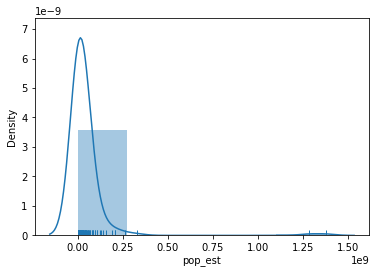

In [27]:
h = seaborn.distplot(gdf['pop_est'], bins=5, rug=True);

In [28]:
gdf['pop_est'].describe()

count    1.770000e+02
mean     4.171237e+07
std      1.459691e+08
min      1.400000e+02
25%      3.360148e+06
50%      9.961396e+06
75%      2.938430e+07
max      1.379303e+09
Name: pop_est, dtype: float64

For quantitative attributes we first sort the data by their value, such that x0≤x2…≤xn−1. For a prespecified number of classes k, the classification problem boils down to selection of k−1 break points along the sorted values that separate the values into mutually exclusive and exhaustive groups.

In fact, the determination of the histogram above can be viewed as one approach to this selection. The method seaborn.distplot uses the matplotlib hist function under the hood to determine the class boundaries and the counts of observations in each class. In the figure, we have five classes which can be extracted with an explicit call to the hist function:

In [30]:
counts, bins, patches = h.hist(gdf['pop_est'], bins=5)

The counts object captures how many observations each category in the classification has:

In [31]:
counts

array([174.,   1.,   0.,   0.,   2.])

The bin object stores these break points we are interested in when considering classification schemes (the patches object can be ignored in this context, as it stores the geometries of the histogram plot):

In [32]:
bins

array([1.40000000e+02, 2.75860666e+08, 5.51721192e+08, 8.27581719e+08,
       1.10344224e+09, 1.37930277e+09])

This yields 5 bins, with the first having a lower bound of 140 and an upper bound of 2.758e+08 which contains 1 observation. The determination of the
interval width ($w$) and the number of bins in `seaborn` is based on the Freedman-Diaconis rule:

$$
w = 2 * IQR * n^{-1/3}
$$

where $IQR$ is the inter quartile
range of the attribute values. Given $w$ the number of bins ($k$) is:

$$k=(max-
min)/w.$$

Below we present several approaches to create these break points that follow criteria that can be of interest in different contexts, as they focus on different priorities.
 
### Equal Intervals

The Freedman-Diaconis approach provides a rule to determine the width and, in
turn, the number of bins for the classification. This is a special case of a
more general classifier known as "equal intervals", where each of the bins has
the same width in the value space. For a given value of $k$, equal intervals
classification splits the range of the attribute space into $k$ equal length
intervals, with each interval having a width $w = \frac{x_0 - x_{n-1}}{k}$. Thus
the maximum class is $(x_{n-1}-w, x_{n-1}]$ and the first class is $(-\infty,
x_{n-1} - (k-1)w]$.

Equal intervals have the dual advantages of simplicity and ease of
interpretation. However, this rule only considers the extreme values of the
distribution and, in some cases, this can result in one or more classes being
sparse. This is clearly the case in our income dataset, as the majority of the
values are placed into the first two classes leaving the last three classes
rather sparse:

In [33]:
ei5 = mapclassify.EqualInterval(gdf['pop_est'], k=5)
ei5

EqualInterval                         

           Interval              Count
--------------------------------------
[       140.00,  275860666.20] |   174
( 275860666.20,  551721192.40] |     1
( 551721192.40,  827581718.60] |     0
( 827581718.60, 1103442244.80] |     0
(1103442244.80, 1379302771.00] |     2

Note that each of the intervals, however, has equal width of w=4093.8. This value of k=5 also coincides with the default classification in the Seaborn histogram displayed in Figure 1. It should also be noted that the first class is closed on the lower bound, in contrast to the general approach defined in Equation (1).

### Quantiles
To avoid the potential problem of sparse classes, the quantiles of
the distribution can be used to identify the class boundaries. Indeed, each
class will have approximately $\mid\frac{n}{k}\mid$ observations using the quantile
classifier. If $k=5$ the sample quintiles are used to define the upper limits of
each class resulting in the following classification:

In [35]:
q5 = mapclassify.Quantiles(gdf.pop_est, k=5)
q5

Quantiles                             

           Interval              Count
--------------------------------------
[       140.00,    2348401.60] |    36
(   2348401.60,    6195124.20] |    35
(   6195124.20,   14323146.80] |    35
(  14323146.80,   38250202.20] |    35
(  38250202.20, 1379302771.00] |    36

Note that while the numbers of values in each class are roughly equal, the widths of the first four intervals are rather different:

In [36]:
q5.bins[1:]-q5.bins[:-1]

array([3.84672260e+06, 8.12802260e+06, 2.39270554e+07, 1.34105257e+09])

While quantiles does avoid the pitfall of sparse classes, this classification is
not problem free. The varying widths of the intervals can be markedly different
which can lead to problems of interpretation. A second challenge facing quantiles
arises when there are a large number of duplicate values in the distribution
such that the limits for one or more classes become ambiguous. For example, if one had a variable with $n=20$ but 10 of the observations took on the same value which was the minimum observed, then for values of $k>2$, the class boundaries become ill-defined since a simple rule of splitting at the $n/k$ ranked observed value would depend upon how ties are treated when ranking.

### Mean-standard deviation

Our third classifer uses the sample mean $\bar{x} =
\frac{1}{n} \sum_{i=1}^n x_i$ and sample standard deviation $s = \sqrt{
\frac{1}{n-1} \sum_{i=1}^n (x_i - \bar{x})  }$ to define class boundaries as
some distance from the sample mean, with the distance being a multiple of the
standard deviation. For example, a common definition for $k=5$ is to set the
upper limit of the first class to two standard deviations ($c_{0}^u = \bar{x} - 2 s$), and the intermediate
classes to have upper limits within one standard deviation ($c_{1}^u = \bar{x}-s,\ c_{2}^u = \bar{x}+s, \ c_{3}^u
= \bar{x}+2s$). Any values greater (smaller) than two standard deviations above (below) the mean
are placed into the top (bottom) class.

In [41]:
msd = mapclassify.StdMean(gdf['pop_est'])
msd

StdMean                               

           Interval              Count
--------------------------------------
(         -inf, -250225811.84] |     0
(-250225811.84, -104256721.00] |     0
(-104256721.00,  187681460.68] |   170
( 187681460.68,  333650551.53] |     5
( 333650551.53, 1379302771.00] |     2

This classifier is best used when data is normally distributed or, at least, when the sample mean is a meaningful measure to anchor the classification around. Clearly this is
not the case for our income data as the positive skew results in a loss of
information when we use the standard deviation. The lack of symmetry leads to
an inadmissible upper bound for the first  class as well as a concentration of the
vast majority of values in the middle class.

### Maximum Breaks

The maximum breaks classifier decides where to set the break points between
classes by considering the difference between sorted values. That is, rather
than considering a value of the dataset in itself, it looks at how appart each
value is from the next one in the sorted sequence. The classifier then places
the the $k-1$ break points in between the pairs of values most stretched apart from
each other in the entire sequence, proceeding in descending order relative to
the size of the breaks:

In [43]:
mb5 = mapclassify.MaximumBreaks(gdf['pop_est'], k=5)
mb5

MaximumBreaks                         

           Interval              Count
--------------------------------------
[       140.00,  233967065.00] |   173
( 233967065.00,  293603265.00] |     1
( 293603265.00,  804280851.00] |     1
( 804280851.00, 1330619341.00] |     1
(1330619341.00, 1379302771.00] |     1

Maximum breaks is an appropriate approach when we are interested in making sure
observations in each class are separated from those in neighboring classes. As
such, it works well in cases where the distribution of values is not unimodal.
In addition, the algorithm is relatively fast to compute. However, its
simplicitly can sometimes cause unexpected results. To the extent in only
considers the top $k-1$ differences between consecutive values, other more nuanced
within-group differences and dissimilarities can be ignored.

### Box-Plot

The box-plot classification is a blend of the quantile and
standard deviation classifiers. Here $k$ is predefined to six, with the upper limit of class 0 set
to $q_{0.25}-h \, IQR$. $IQR = q_{0.75}-q_{0.25}$ is the
inter-quartile range; $h$ corresponds to the hinge, or the multiplier of the $IQR$ to obtain the bounds of the whiskers. The lower limit of the sixth class is set to $q_{0.75}+h \,
IQR$. Intermediate classes have their upper limits set to the 0.25, 0.50 and
0.75 percentiles of the attribute values.

In [44]:
bp = mapclassify.BoxPlot(gdf['pop_est'])
bp

BoxPlot                               

           Interval              Count
--------------------------------------
(         -inf,  -35676075.50] |     0
( -35676075.50,    3360148.00] |    45
(   3360148.00,    9961396.00] |    44
(   9961396.00,   29384297.00] |    44
(  29384297.00,   68420520.50] |    25
(  68420520.50, 1379302771.00] |    19

Any values falling into either of the extreme classes are defined as outlers.
Note that because the income values are non-negative by definition, the lower
outlier class has an inadmissible upper bound meaning that lower outliers would
not be possible for this sample.

The default value for the hinge is $h=1.5$ in
PySAL. However, this can be specified by the user for an alternative classification:

In [46]:
bp1 = mapclassify.BoxPlot(gdf['pop_est'], hinge=1)
bp1

BoxPlot                               

           Interval              Count
--------------------------------------
(         -inf,  -22664001.00] |     0
( -22664001.00,    3360148.00] |    45
(   3360148.00,    9961396.00] |    44
(   9961396.00,   29384297.00] |    44
(  29384297.00,   55408446.00] |    21
(  55408446.00, 1379302771.00] |    23

Doing so will affect the definition of the outlier classes, as well as the
neighboring internal classes.

### Head-Tail Breaks

The head tail algorithm {cite}`Jiang_2013` is based on a recursive partioning of the data using splits around
iterative means. The splitting process continues until the distributions within each of
the classes no longer display a heavy-tailed distribution in the sense that
there is a balance between the number of smaller and larger values assigned to
each class.

In [47]:
ht = mapclassify.HeadTailBreaks(gdf['pop_est'])
ht

HeadTailBreaks                        

           Interval              Count
--------------------------------------
[       140.00,   41712369.84] |   145
(  41712369.84,  182567501.00] |    25
( 182567501.00,  550193675.00] |     5
( 550193675.00, 1330619341.00] |     1
(1330619341.00, 1379302771.00] |     1

For data with a heavy-tailed distribution, such as power law and log normal
distributions, the head tail breaks classifier  can be particularly
effective.

### Jenks Caspall

This approach, as well as the following two, tackles the classification
challenge from a heuristic perspective, rather than from deterministic one.
Originally proposed by {cite}`Jenks_1971`, this algorithm aims to minimize
the sum of absolute deviations around class means. The approach begins with a
prespecified number of classes and an arbitrary initial set of class breaks -
for example using quintiles. The algorithm attempts to improve the objective
function by considering the movement of observations between adjacent classes.
For example, the largest value in the lowest quintile would be considered for
movement into the second quintile, while the lowest value in the second
quintile would be considered for a possible move into the first quintile. The
candidate move resulting in the largest reduction in the objective function
would be made, and the process continues until no other improving moves are
possible.

In [48]:
numpy.random.seed(12345)
jc5 = mapclassify.JenksCaspall(gdf['pop_est'], k=5)
jc5

JenksCaspall                          

           Interval              Count
--------------------------------------
[       140.00,    6653210.00] |    73
(   6653210.00,   20107509.00] |    46
(  20107509.00,   55123814.00] |    35
(  55123814.00,  157826578.00] |    16
( 157826578.00, 1379302771.00] |     7

In [49]:
numpy.random.seed(12345)
fj5 = mapclassify.FisherJenks(gdf['pop_est'], k=5)
fj5

FisherJenks                           

           Interval              Count
--------------------------------------
[       140.00,   22409381.00] |   121
(  22409381.00,   68414135.00] |    37
(  68414135.00,  157826578.00] |    12
( 157826578.00,  326625791.00] |     5
( 326625791.00, 1379302771.00] |     2

### Fisher Jenks

The second optimal algorithm adopts a dynamic programming approach to minimize
the sum of the absolute deviations around class medians. In contrast to the
Jenks-Caspall approach, Fisher-Jenks is guaranteed to produce an optimal
classification for a prespecified number of classes:

### Max-p

Finally, the max-p classifiers adopts the algorithm underlying the max-p region
building method {cite}`Duque_2011` to the case of map classification. It is similar in spirit to
Jenks Caspall in that it considers greedy swapping between adjacent classes to
improve the objective function. It is a heuristic, however, so unlike
Fisher-Jenks, there is no optimial solution guaranteed:

In [50]:
mp5 = mapclassify.MaxP(gdf['pop_est'], k=5)
mp5

MaxP                                  

           Interval              Count
--------------------------------------
[       140.00,    2051363.00] |    33
(   2051363.00,   10768477.00] |    61
(  10768477.00,   15460732.00] |    14
(  15460732.00,   38476269.00] |    34
(  38476269.00, 1379302771.00] |    35

### Comparing Classification schemes

As a special case of clustering, the definition of
the number of classes and the class boundaries pose a problem to the map
designer. Recall that the Freedman-Diaconis rule was said to be optimal,
however, the optimality necessitates the specification of an objective function.
In the case of Freedman-Diaconis, the objective function is to minimize the
difference between the area under estimated kernel density based on the sample
and the area under the theoretical population distribution that generated the
sample.

This notion of statistical fit is an important one. However, it is not the
only consideration when evaluating classifiers for the purpose of choropleth
mapping. Also relevant is the spatial distribution of the attribute values and
the ability of the classifier to convey a sense of that spatial distribution. As
we shall see, this is not necessarily directly related to the statistical
distribution of the attribute values. We will return to a joint consideration of both
the statistical and spatial distribution of the attribute values in comparison
of classifiers below.

For map classification, one optimiality criterion that
can be used is a measure of fit. In PySAL the "absolute deviation around class
medians" (ADCM) is calculated and provides a measure of fit that allows for
comparison of alternative classifiers for the same value of $k$.

To see this, we can compare different classifiers for $k=5$ on the Mexico data:

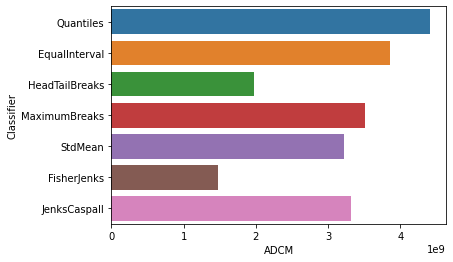

In [51]:
class5 = q5, ei5, ht, mb5, msd, fj5, jc5
fits = numpy.array([ c.adcm for c in class5])
data = pandas.DataFrame(fits)
data['classifier'] = [c.name for c in class5]
data.columns = ['ADCM', 'Classifier']
ax = seaborn.barplot(y='Classifier', x='ADCM', data=data)

As is to be expected, the Fisher-Jenks classifier dominates all other k=5 classifiers with an ACDM of 23,729. Interestingly, the equal interval classifier performs well despite the problems associated with being sensitive to the extreme values in the distribution. The mean-standard deviation classifier has a very poor fit due to the skewed nature of the data and the concentrated assignment of the majority of the observations to the central class.

The ADCM provides a global measure of fit which can be used to compare the alternative classifiers. As a complement to this global perspective, it can be revealing to consider how each of the spatial observations was classified across the alternative approaches. To do this we can add the class bin attribute (yb) generated by the PySAL classifiers as additional columns in the data frame and present these jointly in a table:

In [53]:
gdf['q540'] = q5.yb
gdf['ei540'] = ei5.yb
gdf['ht40'] = ht.yb
gdf['mb540'] = mb5.yb
gdf['msd40'] = msd.yb
gdf['fj540'] = fj5.yb
gdf['jc540'] = jc5.yb

In [54]:
gdfs = gdf.sort_values('pop_est')

In [55]:
def highlight_values(val):
    if val==0:
        return 'background-color: %s' % '#ffffff'
    elif val==1:
        return 'background-color: %s' % '#e0ffff'
    elif val==2:
        return 'background-color: %s' % '#b3ffff'
    elif val==3:
        return 'background-color: %s' % '#87ffff'
    elif val==4:
        return 'background-color: %s' % '#62e4ff'
    else:
        return ''

In [56]:
t = gdfs[['name', 'pop_est', 'q540', 'ei540', 'ht40', 'mb540', 'msd40', 'fj540', 'jc540']]
t.style.applymap(highlight_values)

,name,pop_est,q540,ei540,ht40,mb540,msd40,fj540,jc540
23,Fr. S. Antarctic Lands,140,0,0,0,0,2,0,0
20,Falkland Is.,2931,0,0,0,0,2,0,0
159,Antarctica,4050,0,0,0,0,2,0,0
22,Greenland,57713,0,0,0,0,2,0,0
160,N. Cyprus,265100,0,0,0,0,2,0,0
134,New Caledonia,279070,0,0,0,0,2,0,0
89,Vanuatu,282814,0,0,0,0,2,0,0
19,Bahamas,329988,0,0,0,0,2,0,0
144,Iceland,339747,0,0,0,0,2,0,0
39,Belize,360346,0,0,0,0,2,0,0


Inspection of this table reveals a number of interesting results. First, the only city that is treated consistantly across the k=5 classifiers is China which is placed in the highest class by all classifiers.

Finally, we can consider a meso-level view of the clasification results by comparing the number of values assigned to each class across the different classifiers:

In [57]:
pandas.DataFrame({c.name: c.counts for c in class5},
                 index=['Class-{}'.format(i) for i in range(5)])

,Quantiles,EqualInterval,HeadTailBreaks,MaximumBreaks,StdMean,FisherJenks,JenksCaspall
Class-0,36,174,145,173,0,121,73
Class-1,35,1,25,1,0,37,46
Class-2,35,0,5,1,170,12,35
Class-3,35,0,1,1,5,5,16
Class-4,36,2,1,1,2,2,7


Doing so highlights the similarities between Fisher Jenks and equal intervals as
the distribution counts are very similar as the two approaches agree on all 17
states assigned to the first class. Indeed, the only observation that
distinguishes the two classifiers is the treatment of Baja California Sur which
is kept in class 1 in equal intervals, but assigned to class 2 by Fisher Jenks.

## Color

Having considered the evaluation of the statisitcal distribution of
the attribute values and the alternative classification approaches, the next
step is to select the symbolization and color scheme. Together with the choice of classifier, these will determine the overall
effectiveness of the choropleth map in representing the spatial
distribution of the attribute values.

<AxesSubplot:>

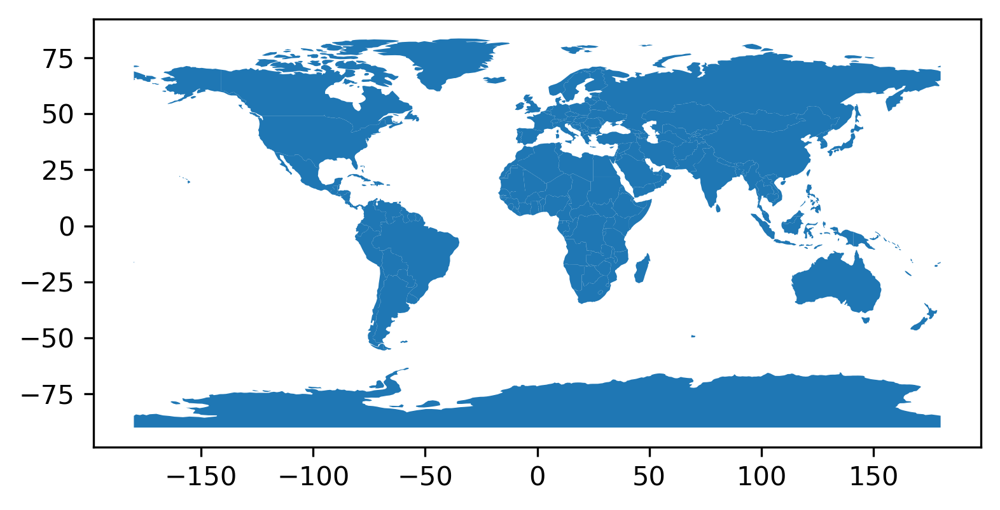

In [6]:
import matplotlib.pyplot as plt
%matplotlib inline
fig, ax = plt.subplots(dpi=300)
gdf.plot(ax=ax)

<AxesSubplot:>

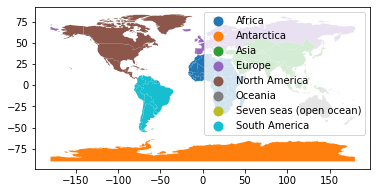

In [75]:
gdf.plot(column="continent", categorical=True, legend=True)

Note how we are using the same approach as for basic maps, the command plot, but we now need to add the argument column to specify which column in particular is to be represented.

- Since the variable is categorical we need to make that explicit by setting the argument categorical to True.

- As an optional argument, we can set legend to True and the resulting figure will include a legend with the names of all the values in the map.

- Unless we specify a different colormap, the selected one respects the categorical nature of the data by not implying a gradient or scale but a qualitative structure.



Prior to examining the attribute values it is important to note that the
spatial units for these states are far from homogenous in their shapes and
sizes. This can have major impacts on our brain's pattern recognition capabilities
as we tend to be drawn to the larger polygons. Yet, when we considered the
statistical distribution above, each observation was given equal weight. Thus,
the spatial distribution becomes more complicated to evaluate from a visual and
statistical perspective.

With this qualification in mind, we will explore the construction of choropleth
maps using geopandas:

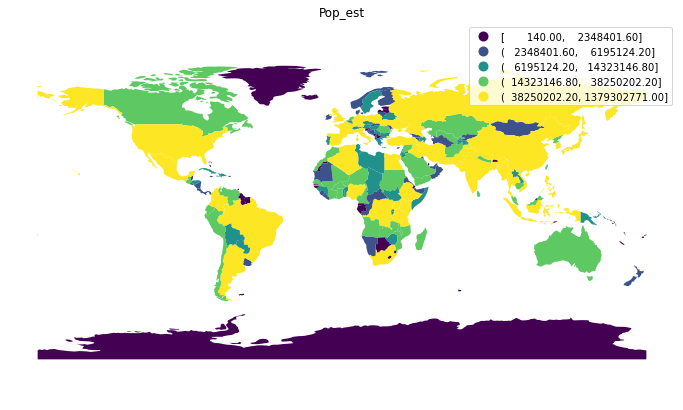

In [66]:
fig, ax = plt.subplots(1, figsize=(12, 7))
gdf.plot(ax=ax, column='pop_est', legend=True, scheme='Quantiles')
ax.set_axis_off()
ax.set_title('Pop_est')
plt.axis('equal')
plt.show()

In [ ]:
Note that the default for the legend is two report two decimal places. If we desire, this can be changed by overriding the `fmt` parameter:

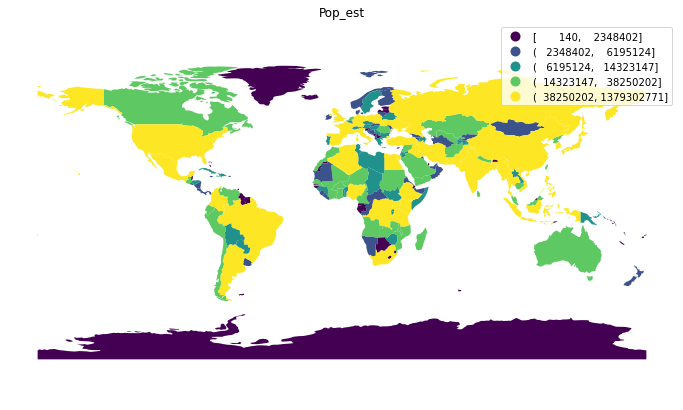

In [67]:
fig, ax = plt.subplots(1, figsize=(12, 7))
gdf.plot(ax=ax, column='pop_est', legend=True, scheme='Quantiles', legend_kwds={'fmt':'{:.0f}'})
ax.set_axis_off()
ax.set_title('Pop_est')
plt.axis('equal')
plt.show()

The default color map used by geopandas is viridis, which is a multi-hue
sequential scheme, with the darker (ligher) hues representing lower (higher)
values for the attribute in question. The choice of a color scheme for a
choropleth map should be based on the type of variable under consideration
{cite}`Brewer1997mapping`. Generally, a distinction is drawn between three
types of numerical attributes:

- sequential
- diverging
- qualitative

### Sequential Color Schemes
Our attribute is measured in dollars and is characterized as a *sequential* attribute. To choose an appropriate sequential scheme we can override the `cmap` parameter:

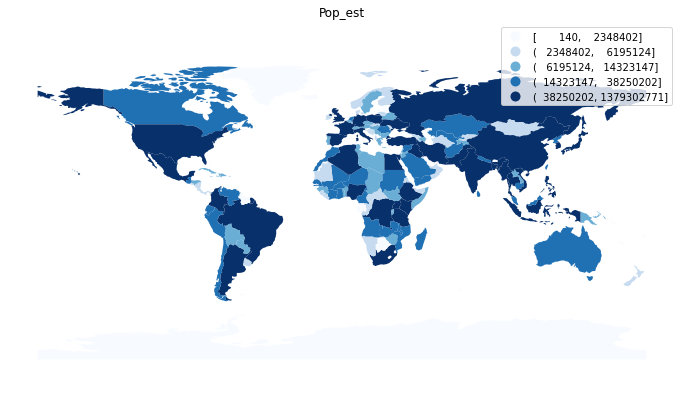

In [69]:
f, ax = plt.subplots(1, figsize=(12,7))
gdf.plot(ax=ax, column='pop_est', legend=True, scheme='Quantiles', legend_kwds={'fmt':'{:.0f}'}, \
         cmap='Blues')
ax.set_axis_off()
ax.set_title('Pop_est')
plt.axis('equal')
plt.show()

which now uses a single-hue sequent,ial color map with the lighter shades representing lower values. One difficulty with this map is that the poor states in the southern portion of Mexico blend into the background of the map display. This can be adjusted by overriding the edgecolor:

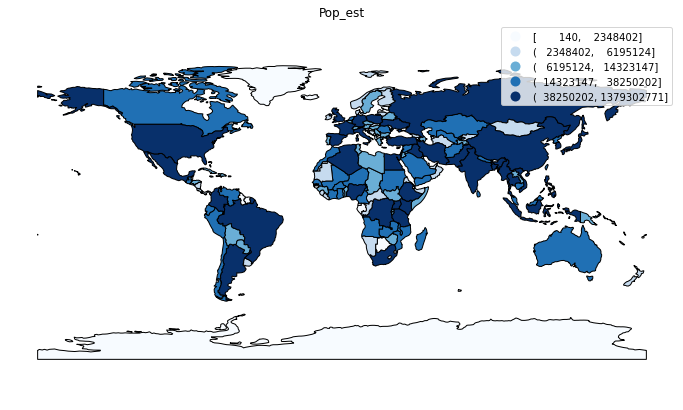

In [70]:
f, ax = plt.subplots(1, figsize=(12,7))
gdf.plot(ax=ax, column='pop_est', legend=True, scheme='Quantiles', legend_kwds={'fmt':'{:.0f}'}, \
         cmap='Blues', edgecolor='k')
ax.set_axis_off()
ax.set_title('Pop_est')
plt.axis('equal')
plt.show()

In [14]:
# We will first normalize the population and GDP values into [0,1] range
# color.to_hex takes a (r, g, b) tuple as input and returns the hex value
# the r, g, b values are expected to be in the [0,1] range
# we will assign r to population and g to GDP
# we will keep b as 0
pop_values = gdf['pop_est'] / gdf['pop_est'].max()
gdp_values = gdf['gdp_md_est'] / gdf['gdp_md_est'].max()
rgb_values = [(x,y,z) for x, y, z in zip(pop_values, gdp_values, [0]*len(pop_values))]
gdf['Color'] = [colors.to_hex(rgb) for rgb in rgb_values]

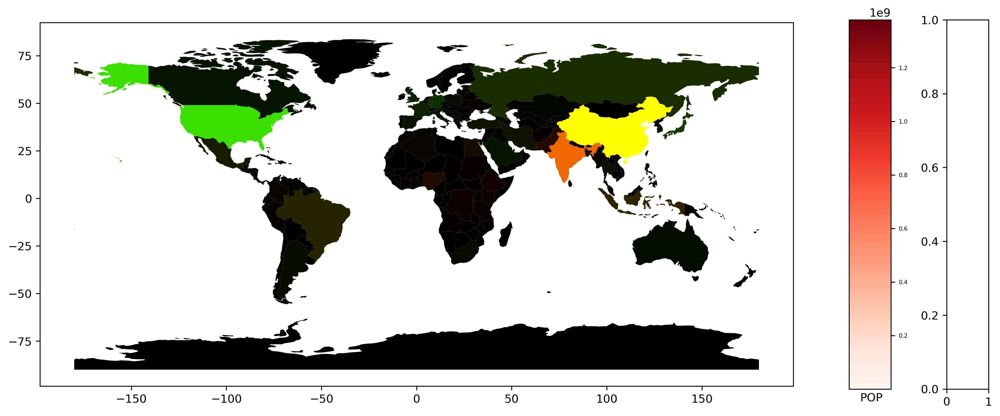

In [18]:
fig, axes = plt.subplots(1, 3, dpi=300,  figsize=(15, 6), gridspec_kw={'width_ratios': [18, 1, 1]})
gdf.plot(ax=axes[0], color=gdf['Color'])
from matplotlib import cm, colors
cmap = 'Reds'
norm = colors.Normalize(vmin=gdf['pop_est'].min(), vmax=gdf['pop_est'].max())
axes[1].tick_params(labelsize=5)
cb = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap),
             cax=axes[1], orientation='vertical')
cb.set_label('POP',labelpad=-32, y=-.01, rotation=0)

## Zooming into the map
A general map of an entire region, or urban area, can sometimes obscure local patterns because they happen at a much smaller scale that cannot be perceived in the global view. One way to solve this is by providing a focus of a smaller part of the map in a separate figure. Although there are many ways to do this in Python, the most straightforward one is to reset the limits of the axes to center them in the area of interest.

As an example, let us consider the quantile map produced above:

<AxesSubplot:>

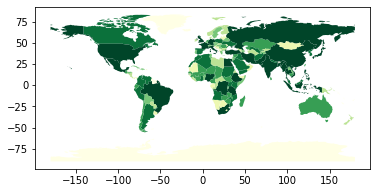

In [76]:
gdf.plot(column="pop_est", scheme="quantiles", k=7, cmap="YlGn", legend=False)

If we want to focus around Colombia, the first step involves realising that such area of the map (the little dark green polygon in the SE centre of the map), falls within the coordinates of -80/-70W, and -5N/10N, roughly speaking. To display a zoom map into that area, we can do as follows:

(-80.0, -65.0)

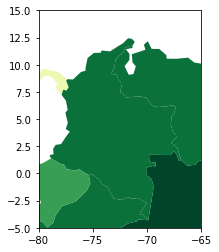

In [78]:
# Setup the figure
f, ax = plt.subplots(1)
# Draw the choropleth
gdf.plot(column="pop_est", 
        scheme="quantiles", 
        k=7,
        cmap="YlGn",
        legend=False,
        ax=ax
       )
# Redimensionate X and Y axes to desired bounds
ax.set_ylim(-5, 15)
ax.set_xlim(-80, -65)

### Partial map

The approach above is straightforward, but not necessarily the most efficient one: not that, to generate a map of a potentially very small area, we effectively draw the entire (potentially very large) map, and discard everything except the section we want. This is not straightforward to notice at first sight, but what Python is doing in the code cell above is plottin the entire `db` object, and only then focusing the figure on the X and Y ranges specified in `set_xlim`/`set_ylim`.

Sometimes, this is required. For example, if we want to retain the same coloring used for the national map, but focus on the region around Mexico DF, this approach is the easiest one.

However, sometimes, we only need to plot the _geographical features_ within a given range, and we either don't need to keep the national coloring (e.g. we are using a single color), or we want a classification performed _only_ with the features in the region.

For these cases, it is computationally more efficient to select the data we want to plot first, and then display them through `plot`. For this, we can rely on the `cx` operator:

<AxesSubplot:>

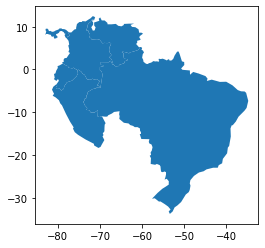

In [79]:
subset = gdf.cx[-80:-65, -5:15]
subset.plot()

We query the range of spatial coordinates similarly to how we query indices with `loc`. Note however the result includes full geographic features, and hence the polygons with at least some area within the range are included fully. This results in a larger range than originally specified.

This approach is a "spatial slice". If you remember when we saw {ref}`non-spatial slices <lab_B:slices>` (enabled by the `loc` operator), this is a similar approach but our selection criteria, instead of subsetting by indices of the table, are based on the spatial coordinates of the data represented in the table.

Since the result is a `GeoDataFrame` itself, we can create a choropleth that is based only on the data in the subset:

<AxesSubplot:>

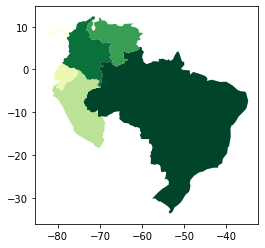

In [80]:
subset.plot(column="pop_est", 
            scheme="quantiles", 
            k=7,
            cmap="YlGn",
            legend=False
           )

## Cartograms
Cartograms are maps that represent the spatial distribution of a variable not by encoding it in a color palette by rather by modifying geographical objects. There are many algorithms to distort the shapes of geographical entities according to values, some of them incredibly complicated and complex.

As an example of how to create a relatively straight-forward cartogram, we will convert polygons into points by using their centroids, and will define the size of the dot proportionally to the value of the variable we want to display, the IMD score in this case. We will adopt a different approach to plot points than we have done so far. This involves first extracting the coordinates of the points:

In [81]:
pts = np.array([(pt.x, pt.y) for pt in gdf.centroid])

C:\Users\usuario\miniconda3\envs\geo\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  """Entry point for launching an IPython kernel.


**NOTE**: The line of code above contains some elements that reflect more advanced Python programming that we have covered so far, so you should feel free to simply run it to extract the points.

---

If you are interested in the logic however, it uses a technique called "list comprehension", which can compress and entire `for` loop into a single line of code, producing more elegant and, to the trained eye, more readable code. Essentially, the line above can be unpacked into the following loop:

In [ ]:
pts = []
for pt in gdf.centroid:
    pts.append((pt.x, pt.y))
pts = np.array(pts)

Once we have extracted them, we can display them through the command `plt.scatter`. This is equivalent to the straightforward `plot`, or to loop over each point, with the difference that it will allow us to modify the size of the dots according to a variable:

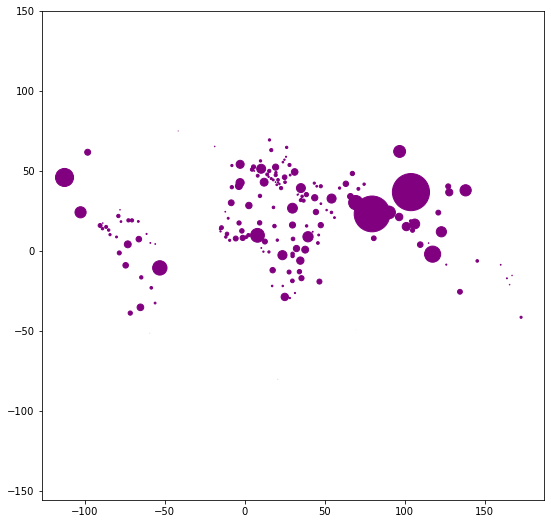

In [83]:
# Set up figure and axes
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot the dots, using `imd_score` as a variable to modify
# the size of each dot
ax.scatter(pts[:, 0], pts[:, 1], c='purple', s=gdf['pop_est'].values/1000000)
# Keep axes proportionate
ax.axis("equal")
# Display
plt.show()

The command `plt.scatter` can also take some of the optional arguments we have learned before, such as color. Have a look at the help of the command ([link](http://matplotlib.org/api/pyplot_api.html#matplotlib.pyplot.scatter)) and try modifying some of them to explore changes in the resulting plot.

## Conditional maps
Conditional maps are an attempt to explore multivariate relationships within a choropleth mapping context. In essence, they are figures composed by several choropleths in which the layout of each of them provides information about the subset of the original dataset represented. The idea is that a dataset can be subset based on one or two conditional variables, usually categorical, and only the observations that meet each characteristic are displayed in a given submap. Since they are combinations of choropleths, they build on everything we have learned about their creation. As an example, let us create a conditional map of IMD scores based on the dominating gender and marital status of each area.

From a Python perspective, creating conditional maps is a bit more intricate than standard choropleths because of the conditioning of the data and the arranging of the layout that needs to occur for the final figure to be produced. To be able to use the facetting machinery available in `seaborn`, we need to define a function that generates a choropleth with a given subset of the dataset:

In [84]:
def map_subset(vals, db, color=None, norm=True):
    '''
    Internal function to pass to `FaceGrid` to build a single map
    ...
    
    Arguments
    ---------
    vals     : Series
               Values of the subplot to be mapped
    db       : GeoDataFrame
               Table with geometries
    color    : None
    '''
    ax = plt.gca()
    db.plot(color='0.8', edgecolor='0.8', linewidth=1., ax=ax)
    vari = vals.name
    if norm:
        db.reindex(vals.index).plot(column=vari, ax=ax, cmap='RdPu', linewidth=0., \
                               vmin=db[vari].min(), vmax=db[vari].max())
    else:
        db.reindex(vals.index).plot(column=vari, ax=ax, cmap='RdPu', linewidth=0.)
    ax.set_axis_off()
    return None

With this function in hand, we can use it to pass it on to the facetting functionality in `seaborn`, which then takes care of the actual subsetting of the data and proper alignment of the output figures:

In [ ]:
import seaborn as sns
g = sns.FacetGrid(gdf, row= "continent", col="name", \
                  margin_titles=True, size=5)
g.map(map_subset, "pop_est", db=gdf)
plt.tight_layout()
plt.show()

C:\Users\usuario\miniconda3\envs\geo\lib\site-packages\seaborn\axisgrid.py:316: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)
